# Import Libraries

In [11]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import zscore

from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import GradientBoostingClassifier
from xgboost import XGBClassifier

from sklearn.metrics import accuracy_score,confusion_matrix,classification_report
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import PowerTransformer

from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
import joblib
import warnings
warnings.filterwarnings('ignore')

In [12]:
#displating max_rows
pd.set_option('display.max_rows',None,'display.max_columns',None)

In [13]:

#Loading the data

df=pd.read_csv("WA_Fn-UseC_-HR-Employee-Attrition.csv")

In [14]:
df.head(10)

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyIncome,MonthlyRate,NumCompaniesWorked,Over18,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,2,Female,94,3,2,Sales Executive,4,Single,5993,19479,8,Y,Yes,11,3,1,80,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,3,Male,61,2,2,Research Scientist,2,Married,5130,24907,1,Y,No,23,4,4,80,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,4,Male,92,2,1,Laboratory Technician,3,Single,2090,2396,6,Y,Yes,15,3,2,80,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,4,Female,56,3,1,Research Scientist,3,Married,2909,23159,1,Y,Yes,11,3,3,80,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,1,Male,40,3,1,Laboratory Technician,2,Married,3468,16632,9,Y,No,12,3,4,80,1,6,3,3,2,2,2,2
5,32,No,Travel_Frequently,1005,Research & Development,2,2,Life Sciences,1,8,4,Male,79,3,1,Laboratory Technician,4,Single,3068,11864,0,Y,No,13,3,3,80,0,8,2,2,7,7,3,6
6,59,No,Travel_Rarely,1324,Research & Development,3,3,Medical,1,10,3,Female,81,4,1,Laboratory Technician,1,Married,2670,9964,4,Y,Yes,20,4,1,80,3,12,3,2,1,0,0,0
7,30,No,Travel_Rarely,1358,Research & Development,24,1,Life Sciences,1,11,4,Male,67,3,1,Laboratory Technician,3,Divorced,2693,13335,1,Y,No,22,4,2,80,1,1,2,3,1,0,0,0
8,38,No,Travel_Frequently,216,Research & Development,23,3,Life Sciences,1,12,4,Male,44,2,3,Manufacturing Director,3,Single,9526,8787,0,Y,No,21,4,2,80,0,10,2,3,9,7,1,8
9,36,No,Travel_Rarely,1299,Research & Development,27,3,Medical,1,13,3,Male,94,3,2,Healthcare Representative,3,Married,5237,16577,6,Y,No,13,3,2,80,2,17,3,2,7,7,7,7


# the target variable is Attrition ,lets work on Classification problem as its categorical data

In [6]:
#duplicates removal
df.drop_duplicates(inplace=True)
df.shape
df.shape

(1470, 35)

there are 1470 rows and 35 columns in the dataset

In [11]:
# Checking data types of each feature
df.dtypes

Age                          int64
Attrition                   object
BusinessTravel              object
DailyRate                    int64
Department                  object
DistanceFromHome             int64
Education                    int64
EducationField              object
EmployeeCount                int64
EmployeeNumber               int64
EnvironmentSatisfaction      int64
Gender                      object
HourlyRate                   int64
JobInvolvement               int64
JobLevel                     int64
JobRole                     object
JobSatisfaction              int64
MaritalStatus               object
MonthlyIncome                int64
MonthlyRate                  int64
NumCompaniesWorked           int64
Over18                      object
OverTime                    object
PercentSalaryHike            int64
PerformanceRating            int64
RelationshipSatisfaction     int64
StandardHours                int64
StockOptionLevel             int64
TotalWorkingYears   

we have int and object datatypes in the dataset. Attrition column needs to be encoded                   

Business Travel,Department,EducationField,Gender,JobRole,MaritalStatus,Over18,OverTime are of object type.  Here All the object type data is of categorical data

# EDA

# Missing values

In [12]:
df.isnull().sum()

Age                         0
Attrition                   0
BusinessTravel              0
DailyRate                   0
Department                  0
DistanceFromHome            0
Education                   0
EducationField              0
EmployeeCount               0
EmployeeNumber              0
EnvironmentSatisfaction     0
Gender                      0
HourlyRate                  0
JobInvolvement              0
JobLevel                    0
JobRole                     0
JobSatisfaction             0
MaritalStatus               0
MonthlyIncome               0
MonthlyRate                 0
NumCompaniesWorked          0
Over18                      0
OverTime                    0
PercentSalaryHike           0
PerformanceRating           0
RelationshipSatisfaction    0
StandardHours               0
StockOptionLevel            0
TotalWorkingYears           0
TrainingTimesLastYear       0
WorkLifeBalance             0
YearsAtCompany              0
YearsInCurrentRole          0
YearsSince

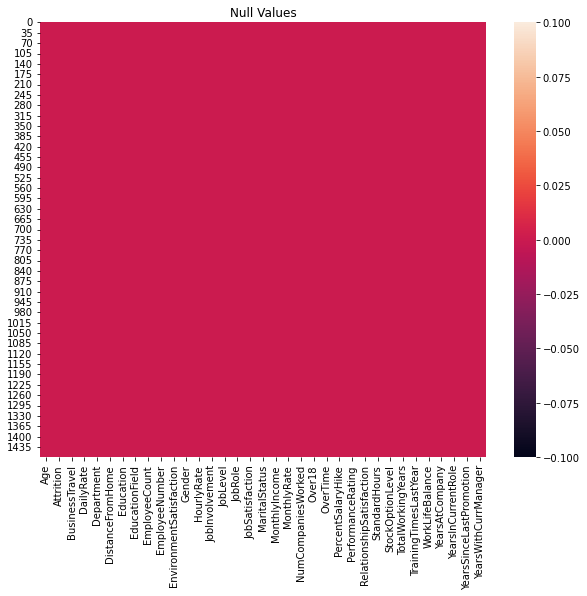

In [13]:
#heatmap on null values
plt.figure(figsize=[10,8])
sns.heatmap(data.isnull())
plt.title("Null Values")
plt.show()


There are no null values in the dataset and no whitespaces also in the dataset.

In [16]:
df

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyIncome,MonthlyRate,NumCompaniesWorked,Over18,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,2,Female,94,3,2,Sales Executive,4,Single,5993,19479,8,Y,Yes,11,3,1,80,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,3,Male,61,2,2,Research Scientist,2,Married,5130,24907,1,Y,No,23,4,4,80,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,4,Male,92,2,1,Laboratory Technician,3,Single,2090,2396,6,Y,Yes,15,3,2,80,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,4,Female,56,3,1,Research Scientist,3,Married,2909,23159,1,Y,Yes,11,3,3,80,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,1,Male,40,3,1,Laboratory Technician,2,Married,3468,16632,9,Y,No,12,3,4,80,1,6,3,3,2,2,2,2
5,32,No,Travel_Frequently,1005,Research & Development,2,2,Life Sciences,1,8,4,Male,79,3,1,Laboratory Technician,4,Single,3068,11864,0,Y,No,13,3,3,80,0,8,2,2,7,7,3,6
6,59,No,Travel_Rarely,1324,Research & Development,3,3,Medical,1,10,3,Female,81,4,1,Laboratory Technician,1,Married,2670,9964,4,Y,Yes,20,4,1,80,3,12,3,2,1,0,0,0
7,30,No,Travel_Rarely,1358,Research & Development,24,1,Life Sciences,1,11,4,Male,67,3,1,Laboratory Technician,3,Divorced,2693,13335,1,Y,No,22,4,2,80,1,1,2,3,1,0,0,0
8,38,No,Travel_Frequently,216,Research & Development,23,3,Life Sciences,1,12,4,Male,44,2,3,Manufacturing Director,3,Single,9526,8787,0,Y,No,21,4,2,80,0,10,2,3,9,7,1,8
9,36,No,Travel_Rarely,1299,Research & Development,27,3,Medical,1,13,3,Male,94,3,2,Healthcare Representative,3,Married,5237,16577,6,Y,No,13,3,2,80,2,17,3,2,7,7,7,7


In [17]:
#Checking unique values in each column
df.nunique()

Age                           43
Attrition                      2
BusinessTravel                 3
DailyRate                    886
Department                     3
DistanceFromHome              29
Education                      5
EducationField                 6
EmployeeCount                  1
EmployeeNumber              1470
EnvironmentSatisfaction        4
Gender                         2
HourlyRate                    71
JobInvolvement                 4
JobLevel                       5
JobRole                        9
JobSatisfaction                4
MaritalStatus                  3
MonthlyIncome               1349
MonthlyRate                 1427
NumCompaniesWorked            10
Over18                         1
OverTime                       2
PercentSalaryHike             15
PerformanceRating              2
RelationshipSatisfaction       4
StandardHours                  1
StockOptionLevel               4
TotalWorkingYears             40
TrainingTimesLastYear          7
WorkLifeBa

we can see that in object columns StandardHours,Over18,EmployeeCount  are of unique values .So it wont be having any effect on the models so we can drop these columns                    

we can see the EmployeeNumber is having some pattern even though they are unique numbers .so lets not drop this column

In [15]:
#Droping unwanted columns from the dataset
df.drop(['Over18','StandardHours','EmployeeCount'], axis=1, inplace = True )

In [201]:
#Checking for value count of target column
df['Attrition'].value_counts()

No     1233
Yes     237
Name: Attrition, dtype: int64

The label  seems to be unbalanced we need to balance the dataset later using Oversampling.

In [19]:
#describing the data set
df.describe(include='O')

,Attrition,BusinessTravel,Department,EducationField,Gender,JobRole,MaritalStatus,OverTime
count,1470,1470,1470,1470,1470,1470,1470,1470
unique,2,3,3,6,2,9,3,2
top,No,Travel_Rarely,Research & Development,Life Sciences,Male,Sales Executive,Married,No
freq,1233,1043,961,606,882,326,673,1054


In [20]:
#describing the data set
df.describe()

,Age,DailyRate,DistanceFromHome,Education,EmployeeNumber,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,JobSatisfaction,MonthlyIncome,MonthlyRate,NumCompaniesWorked,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
count,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000
mean,36.923810,802.485714,9.192517,2.912925,1024.865306,2.721769,65.891156,2.729932,2.063946,2.728571,6502.931293,14313.103401,2.693197,15.209524,3.153741,2.712245,0.793878,11.279592,2.799320,2.761224,7.008163,4.229252,2.187755,4.123129
std,9.135373,403.509100,8.106864,1.024165,602.024335,1.093082,20.329428,0.711561,1.106940,1.102846,4707.956783,7117.786044,2.498009,3.659938,0.360824,1.081209,0.852077,7.780782,1.289271,0.706476,6.126525,3.623137,3.222430,3.568136
min,18.000000,102.000000,1.000000,1.000000,1.000000,1.000000,30.000000,1.000000,1.000000,1.000000,1009.000000,2094.000000,0.000000,11.000000,3.000000,1.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
25%,30.000000,465.000000,2.000000,2.000000,491.250000,2.000000,48.000000,2.000000,1.000000,2.000000,2911.000000,8047.000000,1.000000,12.000000,3.000000,2.000000,0.000000,6.000000,2.000000,2.000000,3.000000,2.000000,0.000000,2.000000
50%,36.000000,802.000000,7.000000,3.000000,1020.500000,3.000000,66.000000,3.000000,2.000000,3.000000,4919.000000,14235.500000,2.000000,14.000000,3.000000,3.000000,1.000000,10.000000,3.000000,3.000000,5.000000,3.000000,1.000000,3.000000
75%,43.000000,1157.000000,14.000000,4.000000,1555.750000,4.000000,83.750000,3.000000,3.000000,4.000000,8379.000000,20461.500000,4.000000,18.000000,3.000000,4.000000,1.000000,15.000000,3.000000,3.000000,9.000000,7.000000,3.000000,7.000000
max,60.000000,1499.000000,29.000000,5.000000,2068.000000,4.000000,100.000000,4.000000,5.000000,4.000000,19999.000000,26999.000000,9.000000,25.000000,4.000000,4.000000,3.000000,40.000000,6.000000,4.000000,40.000000,18.000000,15.000000,17.000000


*difference between 3rd quantile to max is very high in some of the columns.

*By looking into above observations We can say that in some of the columns there are extream outliers in the dataset.

<AxesSubplot:>

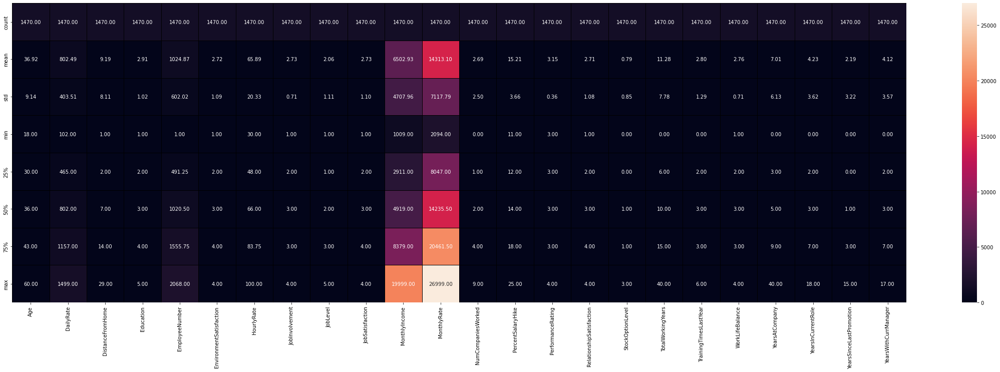

In [44]:
plt.figure(figsize=(40,11))
sns.heatmap(df.describe(),annot=True,linewidths=1,linecolor="black",fmt="0.2f")

# Visualization

<AxesSubplot:xlabel='Attrition', ylabel='count'>

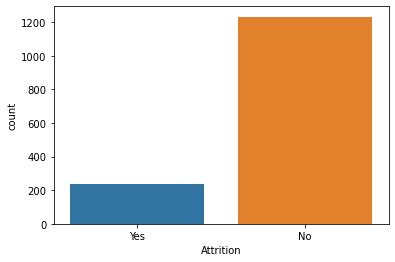

In [10]:
#Count plot for target
sns.countplot(x=df['Attrition'])

we have a  imbalanced data in target column.

<AxesSubplot:xlabel='BusinessTravel', ylabel='count'>

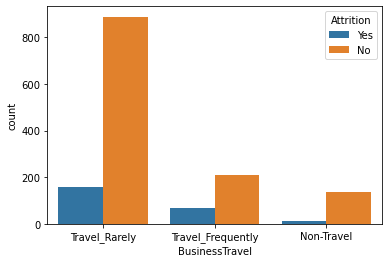

In [29]:
#Factor plot for BusinessTravel
sns.countplot('BusinessTravel',data=df,hue='Attrition') 

<AxesSubplot:xlabel='Department', ylabel='count'>

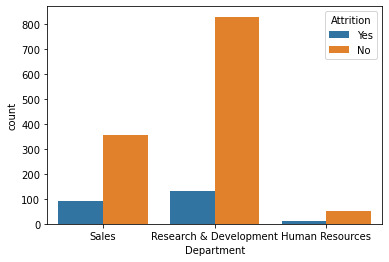

In [30]:
#Factor plot for Department
sns.countplot('Department',data=df,hue='Attrition')

<AxesSubplot:xlabel='Gender', ylabel='count'>

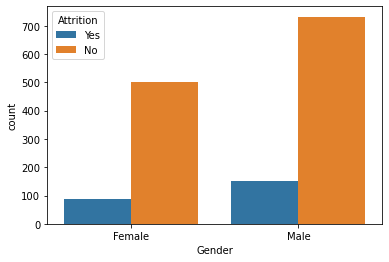

In [31]:
#Factor plot for Gender
sns.countplot('Gender',data=df,hue='Attrition')

<AxesSubplot:xlabel='JobRole', ylabel='count'>

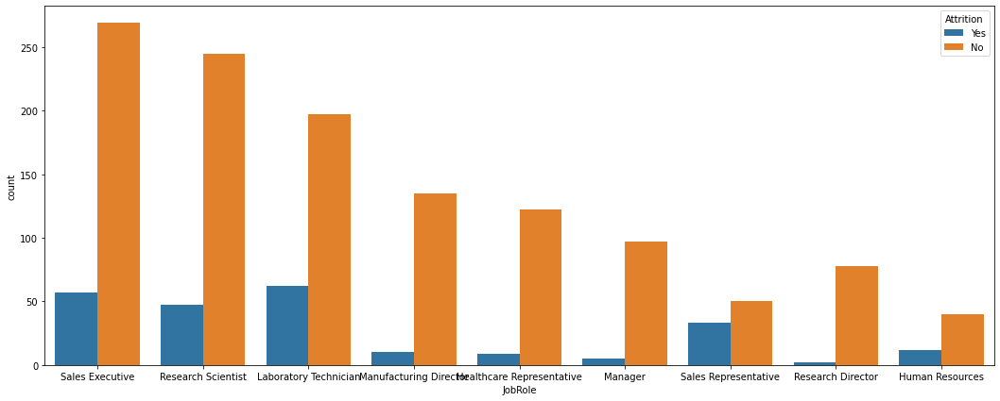

In [36]:
#Factor plot for JobRole
plt.figure(figsize=(18,7))
sns.countplot('JobRole',data=df,hue='Attrition')

attrition rates can be seen in a decreasing trent in allmost all the category

<AxesSubplot:xlabel='MaritalStatus', ylabel='count'>

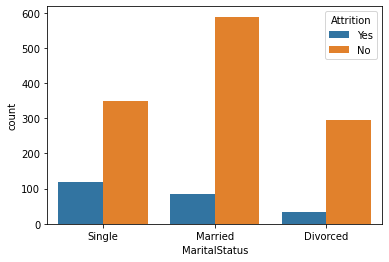

In [37]:
#Factor plot for MaritalStatus
sns.countplot('MaritalStatus',data=df,hue='Attrition')

<AxesSubplot:xlabel='OverTime', ylabel='count'>

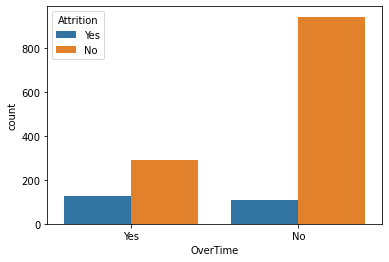

In [38]:
#Factor plot for OverTime
sns.countplot('OverTime',data=df,hue='Attrition')

In Overtime the attrition is higher compared to Non overtime category

<AxesSubplot:xlabel='EducationField', ylabel='count'>

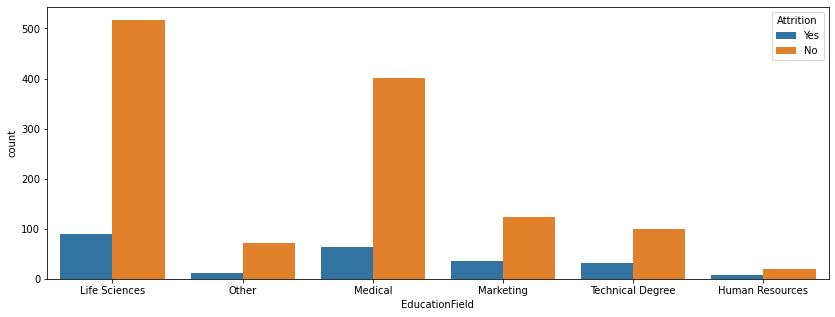

In [41]:
plt.figure(figsize=(14,5))
sns.countplot('EducationField',data=df,hue='Attrition')

In [42]:
df['NumCompaniesWorked'].value_counts()

1    521
0    197
3    159
2    146
4    139
7     74
6     70
5     63
9     52
8     49
Name: NumCompaniesWorked, dtype: int64

Fresher data is of 197 and highest number of companies worked by employee is 9 (52 people) and the max number of people are having experience of 1

In [202]:
columns=df.columns

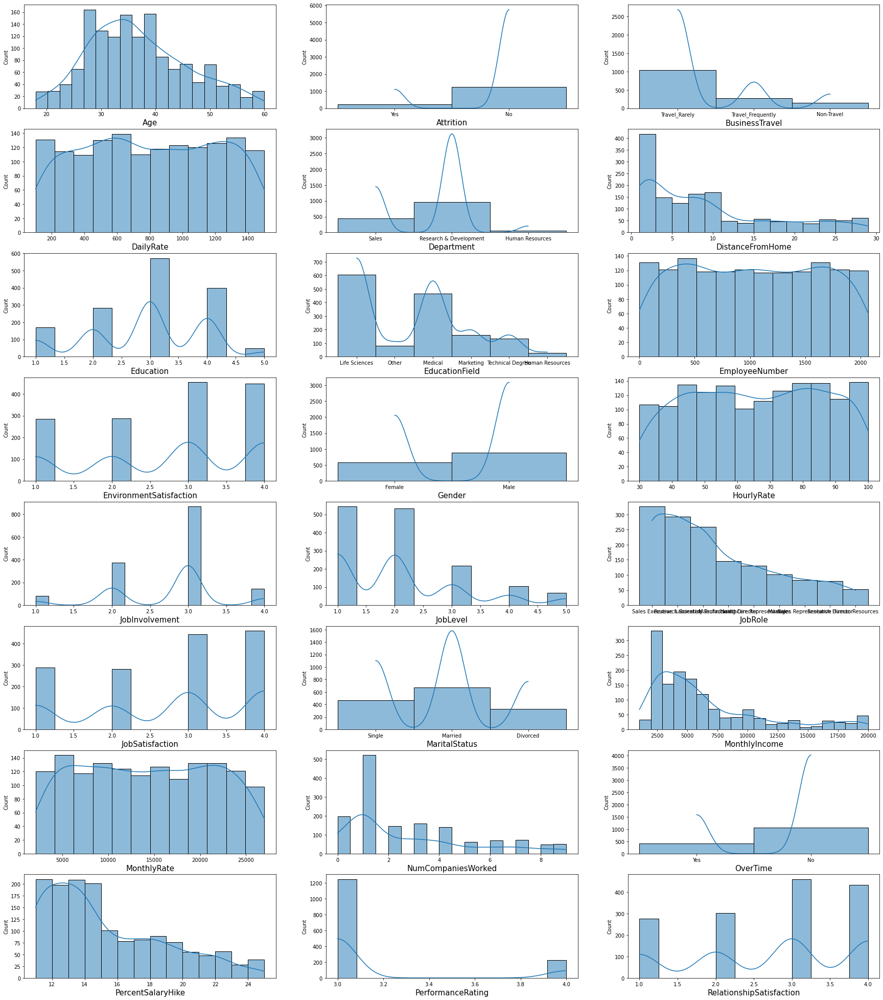

In [50]:
    
# let's see how data is distributed for every Numerical column using histogram plot
plt.figure(figsize=(30,35), facecolor='white')
plotnumber = 1

for column in df[columns]:
    if plotnumber<=24 :
        ax = plt.subplot(8,3,plotnumber)
        sns.histplot(df[column],kde=True)
        plt.xlabel(column,fontsize=15)
       
    plotnumber+=1
plt.show()

In [59]:
df.columns

Index(['Age', 'Attrition', 'BusinessTravel', 'DailyRate', 'Department',
       'DistanceFromHome', 'Education', 'EducationField', 'EmployeeNumber',
       'EnvironmentSatisfaction', 'Gender', 'HourlyRate', 'JobInvolvement',
       'JobLevel', 'JobRole', 'JobSatisfaction', 'MaritalStatus',
       'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked', 'OverTime',
       'PercentSalaryHike', 'PerformanceRating', 'RelationshipSatisfaction',
       'StockOptionLevel', 'TotalWorkingYears', 'TrainingTimesLastYear',
       'WorkLifeBalance', 'YearsAtCompany', 'YearsInCurrentRole',
       'YearsSinceLastPromotion', 'YearsWithCurrManager'],
      dtype='object')

# Checking distribution relationship

<AxesSubplot:xlabel='Department', ylabel='Attrition'>

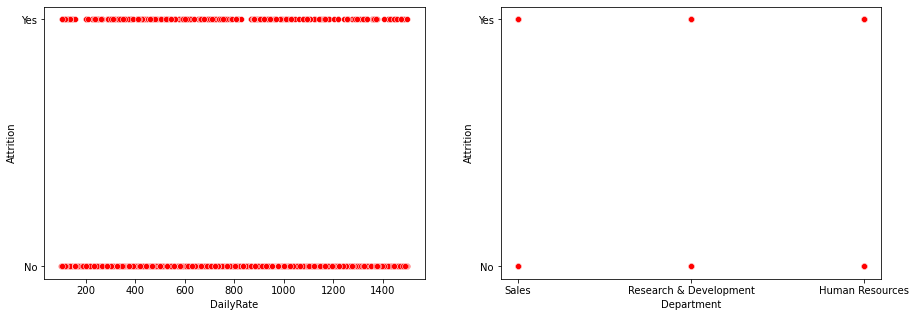

In [66]:
plt.figure(figsize=(15,5))
plt.subplot(1,2,1)
sns.scatterplot(x=df['Age'],y=df['Attrition'],color='red')
plt.subplot(1,2,2)
sns.scatterplot(x=df['DailyRate'],y=df['Attrition'],color='red')


<AxesSubplot:xlabel='EmployeeNumber', ylabel='Attrition'>

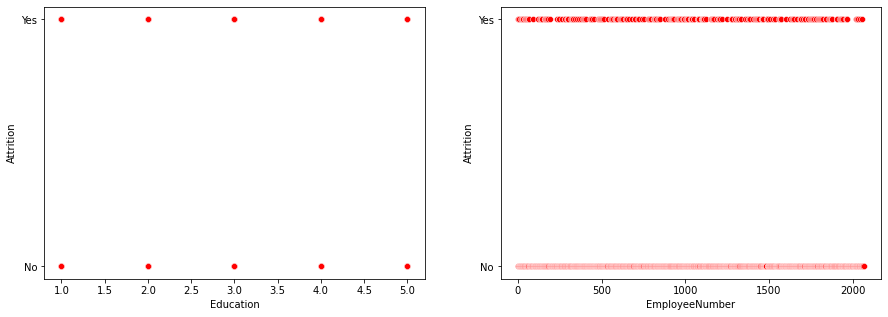

In [70]:
plt.figure(figsize=(15,5))
plt.subplot(1,2,1)
sns.scatterplot(x=df['Education'],y=df['Attrition'],color='red')
plt.subplot(1,2,2)
sns.scatterplot(x=df['EmployeeNumber'],y=df['Attrition'],color='red')

<AxesSubplot:xlabel='HourlyRate', ylabel='Attrition'>

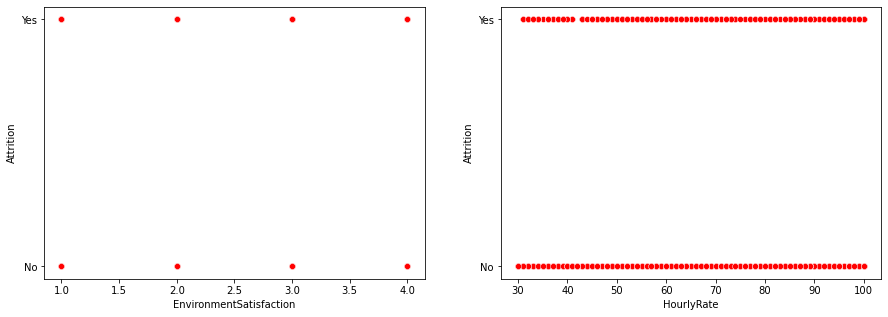

In [71]:
plt.figure(figsize=(15,5))
plt.subplot(1,2,1)
sns.scatterplot(x=df['EnvironmentSatisfaction'],y=df['Attrition'],color='red')
plt.subplot(1,2,2)
sns.scatterplot(x=df['HourlyRate'],y=df['Attrition'],color='red')

<AxesSubplot:xlabel='JobLevel', ylabel='Attrition'>

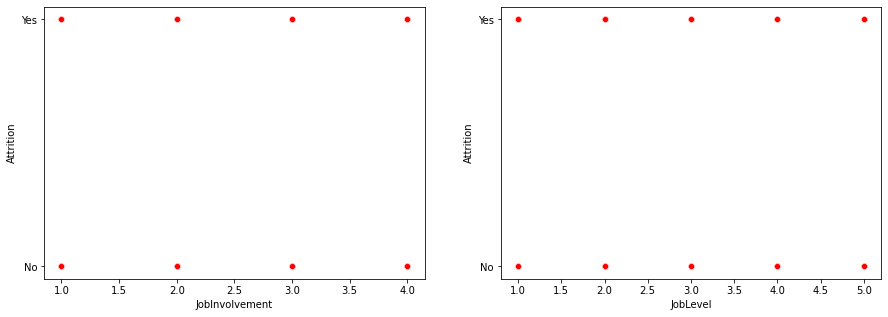

In [72]:
plt.figure(figsize=(15,5))
plt.subplot(1,2,1)
sns.scatterplot(x=df['JobInvolvement'],y=df['Attrition'],color='red')
plt.subplot(1,2,2)
sns.scatterplot(x=df['JobLevel'],y=df['Attrition'],color='red')

<AxesSubplot:xlabel='MonthlyIncome', ylabel='Attrition'>

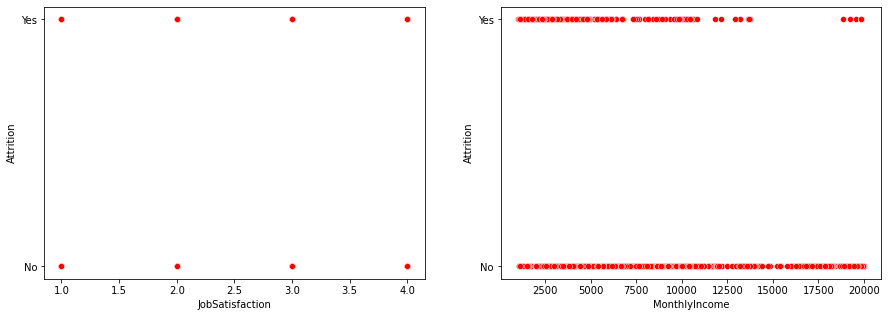

In [74]:
plt.figure(figsize=(15,5))
plt.subplot(1,2,1)
sns.scatterplot(x=df['JobSatisfaction'],y=df['Attrition'],color='red')
plt.subplot(1,2,2)
sns.scatterplot(x=df['MonthlyIncome'],y=df['Attrition'],color='red')

<AxesSubplot:xlabel='MonthlyRate', ylabel='Attrition'>

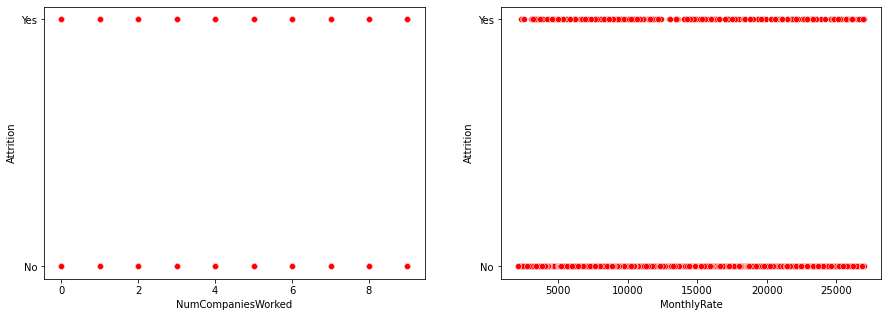

In [76]:
plt.figure(figsize=(15,5))
plt.subplot(1,2,1)
sns.scatterplot(x=df['NumCompaniesWorked'],y=df['Attrition'],color='red')
plt.subplot(1,2,2)
sns.scatterplot(x=df['MonthlyRate'],y=df['Attrition'],color='red')

<AxesSubplot:xlabel='PerformanceRating', ylabel='Attrition'>

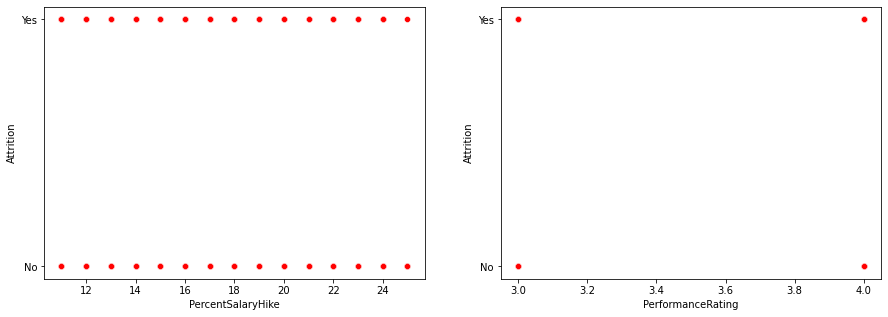

In [77]:
plt.figure(figsize=(15,5))
plt.subplot(1,2,1)
sns.scatterplot(x=df['PercentSalaryHike'],y=df['Attrition'],color='red')
plt.subplot(1,2,2)
sns.scatterplot(x=df['PerformanceRating'],y=df['Attrition'],color='red')

<AxesSubplot:xlabel='StockOptionLevel', ylabel='Attrition'>

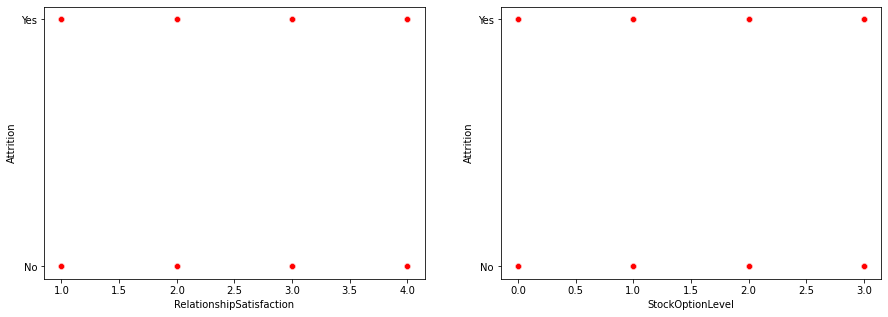

In [78]:
plt.figure(figsize=(15,5))
plt.subplot(1,2,1)
sns.scatterplot(x=df['RelationshipSatisfaction'],y=df['Attrition'],color='red')
plt.subplot(1,2,2)
sns.scatterplot(x=df['StockOptionLevel'],y=df['Attrition'],color='red')

<AxesSubplot:xlabel='TrainingTimesLastYear', ylabel='Attrition'>

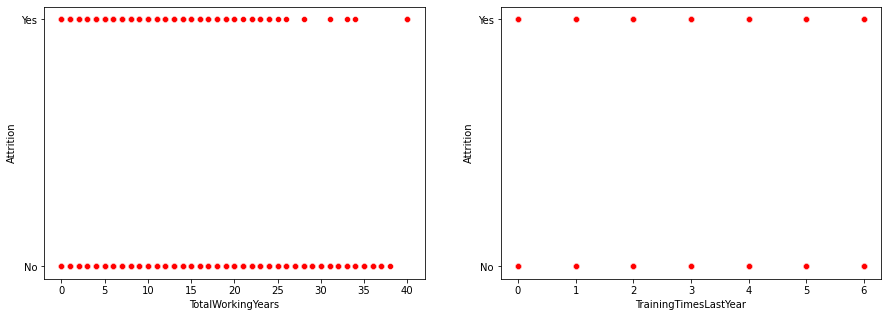

In [79]:
plt.figure(figsize=(15,5))
plt.subplot(1,2,1)
sns.scatterplot(x=df['TotalWorkingYears'],y=df['Attrition'],color='red')
plt.subplot(1,2,2)
sns.scatterplot(x=df['TrainingTimesLastYear'],y=df['Attrition'],color='red')

In [ ]:
in RelationshipSatisfaction the data is unevenly distributed  and scattered.the data is distributed in the range of 1 to 4.

in TrainingTimesLastYear the data is unevenly distributed  and scattered.the data is distributed in the range of 0 to 6.

<AxesSubplot:xlabel='YearsAtCompany', ylabel='Attrition'>

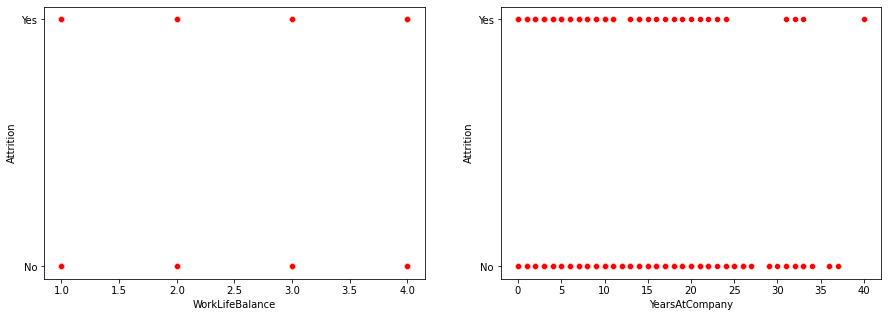

In [80]:
plt.figure(figsize=(15,5))
plt.subplot(1,2,1)
sns.scatterplot(x=df['WorkLifeBalance'],y=df['Attrition'],color='red')
plt.subplot(1,2,2)
sns.scatterplot(x=df['YearsAtCompany'],y=df['Attrition'],color='red')

<AxesSubplot:xlabel='YearsWithCurrManager', ylabel='Attrition'>

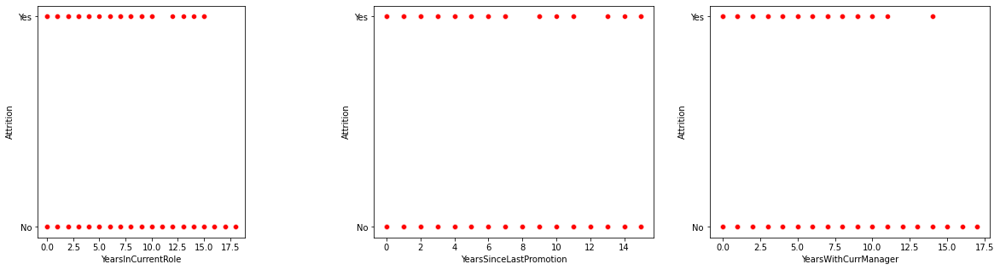

In [81]:
plt.figure(figsize=(20,5))
plt.subplot(1,4,1)
sns.scatterplot(x=df['YearsInCurrentRole'],y=df['Attrition'],color='red')
plt.subplot(1,3,2)
sns.scatterplot(x=df['YearsSinceLastPromotion'],y=df['Attrition'],color='red')
plt.subplot(1,3,3)
sns.scatterplot(x=df['YearsWithCurrManager'],y=df['Attrition'],color='red')

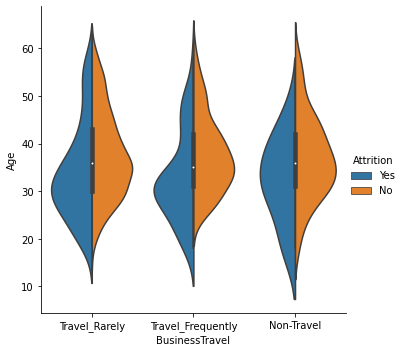

In [57]:
# Let's plot catplot for BusinessTravel and Age
sns.catplot(x = "BusinessTravel", y = "Age", hue = "Attrition",kind = "violin",data=df,split=True)

In [82]:
df.columns

Index(['Age', 'Attrition', 'BusinessTravel', 'DailyRate', 'Department',
       'DistanceFromHome', 'Education', 'EducationField', 'EmployeeNumber',
       'EnvironmentSatisfaction', 'Gender', 'HourlyRate', 'JobInvolvement',
       'JobLevel', 'JobRole', 'JobSatisfaction', 'MaritalStatus',
       'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked', 'OverTime',
       'PercentSalaryHike', 'PerformanceRating', 'RelationshipSatisfaction',
       'StockOptionLevel', 'TotalWorkingYears', 'TrainingTimesLastYear',
       'WorkLifeBalance', 'YearsAtCompany', 'YearsInCurrentRole',
       'YearsSinceLastPromotion', 'YearsWithCurrManager'],
      dtype='object')

<Figure size 360x360 with 0 Axes>

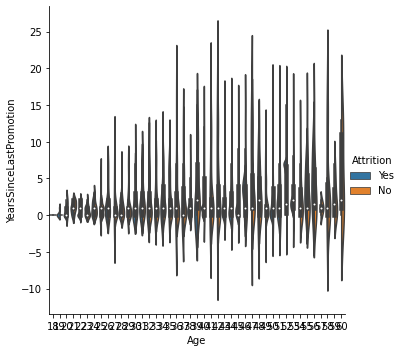

In [87]:
plt.figure(figsize=(5,5))
# Let's plot catplot for Age and YearsSinceLastPromotion
sns.catplot(x = "Age", y = "YearsSinceLastPromotion", hue = "Attrition", kind = "violin", data=df, split=True)

In [ ]:
as  the age increases the time taken for next promotion time increases and attrition levle is also high in this case

Company can get good efficiency from employees if the distance from home lies between 0-10

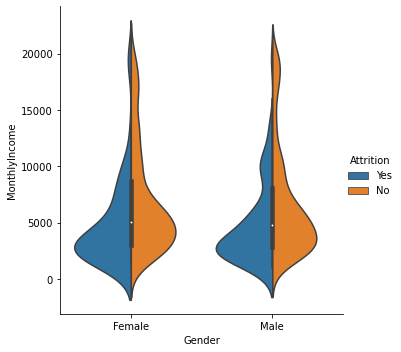

In [89]:
# Let's plot catplot for Gender and MonthlyIncome
sns.catplot(x = "Gender", y = "MonthlyIncome", hue = "Attrition", kind = "violin", data=df, split=True)

Both male and female has almost same income with attrition.

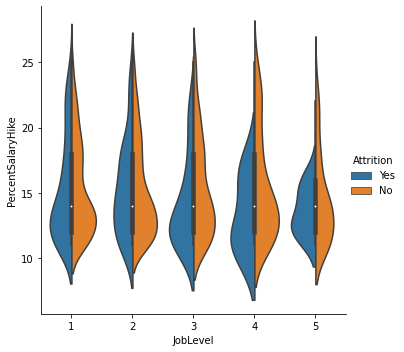

In [90]:
# Let's plot catplot for JobLevel and PercentSalaryHike
sns.catplot(x = "JobLevel", y = "PercentSalaryHike", hue = "Attrition", kind = "violin", data=df, split=True)

we are able to observe an increase in attrition rate yes with job level increases compared to each joblevel.
The attriton rate No is small with  an increase in joblevel

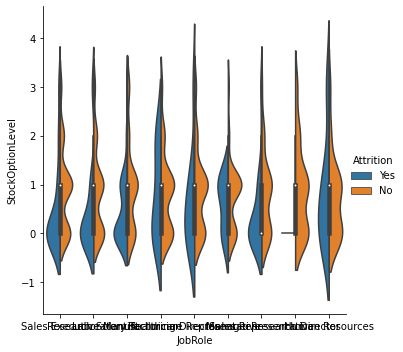

In [91]:
# Let's plot catplot for JobRole and StockOptionLevel
sns.catplot(x = "JobRole", y = "StockOptionLevel", hue = "Attrition", kind = "violin", data=df, split=True)

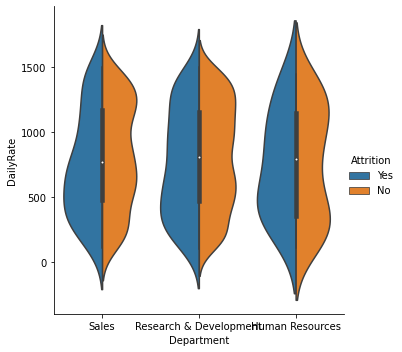

In [92]:
# Let's plot catplot for Department and DailyRate
sns.catplot(x = "Department", y = "DailyRate", hue = "Attrition", kind = "violin", data=df, split=True)

in each department we are able to observe similar no of data in each department for Attrition rate.

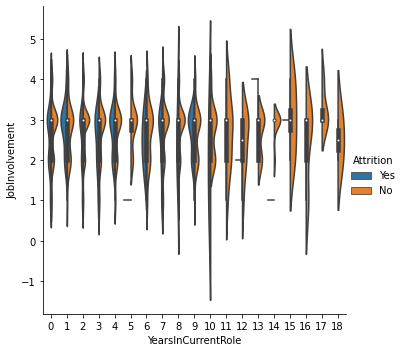

In [93]:
# Let's plot catplot for YearsInCurrentRole and JobInvolvement
sns.catplot(x = "YearsInCurrentRole", y = "JobInvolvement", hue = "Attrition", kind = "violin", data=df, split=True)

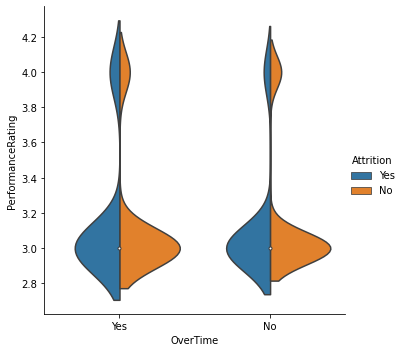

In [94]:
# Let's plot catplot for OverTime and PerformanceRating
sns.catplot(x = "OverTime", y = "PerformanceRating", hue = "Attrition", kind = "violin", data=df, split=True)

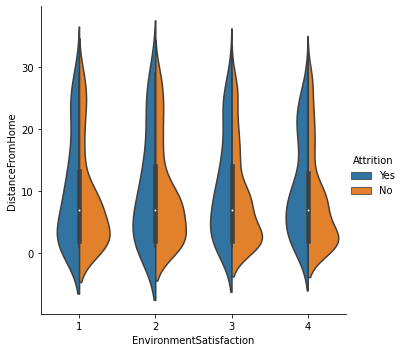

In [95]:
# Let's plot catplot for DistanceFromHome and EnvironmentSatisfaction
sns.catplot(y = "DistanceFromHome",x = "EnvironmentSatisfaction", hue = "Attrition", kind = "violin", data=df, split=True)

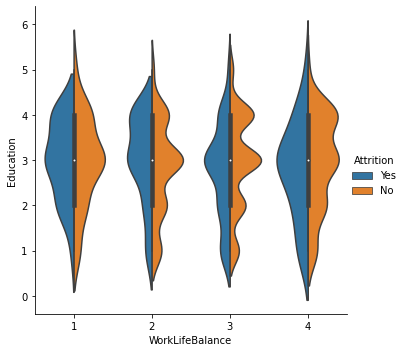

In [96]:
# Let's plot catplot for WorkLifeBalance and Education
sns.catplot(x = "WorkLifeBalance", y = "Education", hue = "Attrition", kind = "violin", data=df, split=True)

worklife balance shows that attrition level is low on each class of data in the dataset.We can observe ahigher data available as the education increases

# Multivariate Analysis

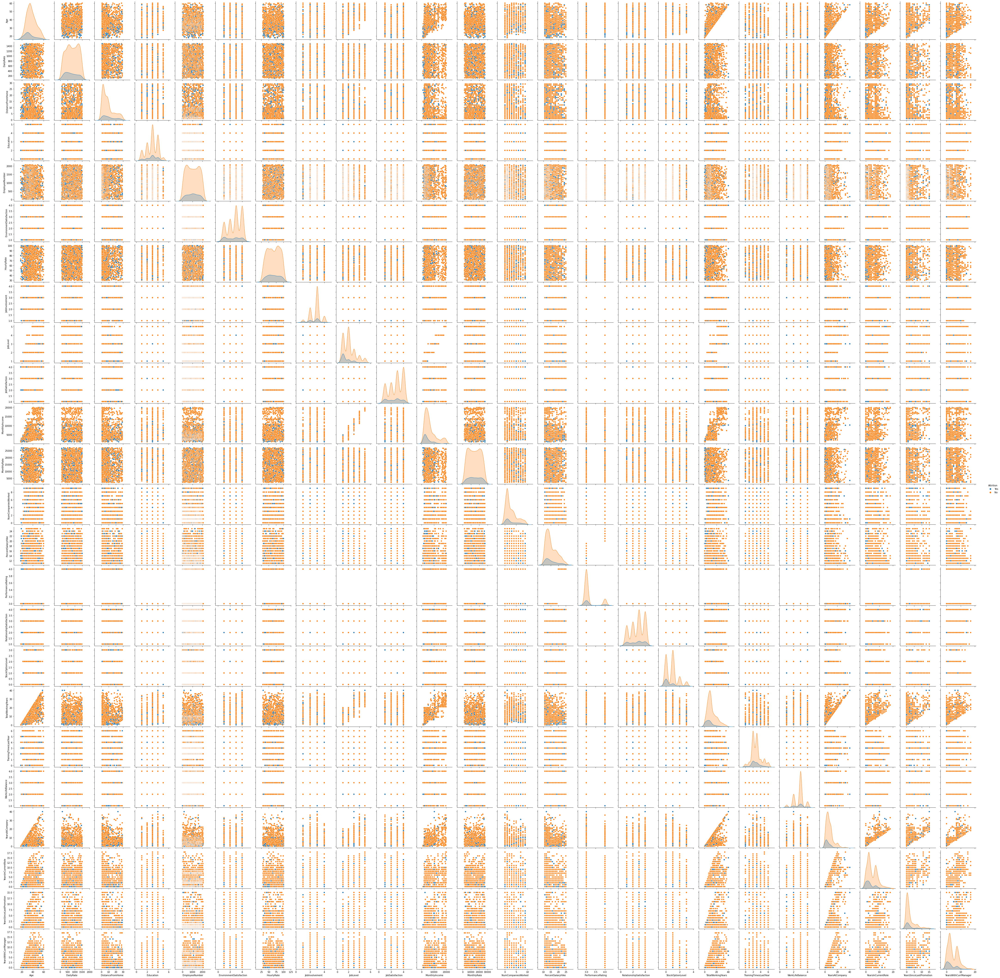

In [97]:
#pair ploting for dataset
sns.pairplot(df,hue="Attrition")

Above are the pair plots of each pair of columns in the data set.By looking into the plot we can see there are some negative correlated columns and some extreme outliers present in the dataset

In [98]:
df

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeNumber,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyIncome,MonthlyRate,NumCompaniesWorked,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,2,Female,94,3,2,Sales Executive,4,Single,5993,19479,8,Yes,11,3,1,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,2,3,Male,61,2,2,Research Scientist,2,Married,5130,24907,1,No,23,4,4,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,4,4,Male,92,2,1,Laboratory Technician,3,Single,2090,2396,6,Yes,15,3,2,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,5,4,Female,56,3,1,Research Scientist,3,Married,2909,23159,1,Yes,11,3,3,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,7,1,Male,40,3,1,Laboratory Technician,2,Married,3468,16632,9,No,12,3,4,1,6,3,3,2,2,2,2
5,32,No,Travel_Frequently,1005,Research & Development,2,2,Life Sciences,8,4,Male,79,3,1,Laboratory Technician,4,Single,3068,11864,0,No,13,3,3,0,8,2,2,7,7,3,6
6,59,No,Travel_Rarely,1324,Research & Development,3,3,Medical,10,3,Female,81,4,1,Laboratory Technician,1,Married,2670,9964,4,Yes,20,4,1,3,12,3,2,1,0,0,0
7,30,No,Travel_Rarely,1358,Research & Development,24,1,Life Sciences,11,4,Male,67,3,1,Laboratory Technician,3,Divorced,2693,13335,1,No,22,4,2,1,1,2,3,1,0,0,0
8,38,No,Travel_Frequently,216,Research & Development,23,3,Life Sciences,12,4,Male,44,2,3,Manufacturing Director,3,Single,9526,8787,0,No,21,4,2,0,10,2,3,9,7,1,8
9,36,No,Travel_Rarely,1299,Research & Development,27,3,Medical,13,3,Male,94,3,2,Healthcare Representative,3,Married,5237,16577,6,No,13,3,2,2,17,3,2,7,7,7,7


# Encoding the Categorical columns

we have 8 categorical columns in the dataset

In [16]:
#assigning categorical columns in list
categ = ["Attrition","BusinessTravel","Department","EducationField","Gender","JobRole","MaritalStatus","OverTime"]

In [17]:
from sklearn.preprocessing import LabelEncoder
LE=LabelEncoder()
df[categ]= df[categ].apply(LE.fit_transform)

In [18]:
df.head(100)

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeNumber,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyIncome,MonthlyRate,NumCompaniesWorked,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,1,2,1102,2,1,2,1,1,2,0,94,3,2,7,4,2,5993,19479,8,1,11,3,1,0,8,0,1,6,4,0,5
1,49,0,1,279,1,8,1,1,2,3,1,61,2,2,6,2,1,5130,24907,1,0,23,4,4,1,10,3,3,10,7,1,7
2,37,1,2,1373,1,2,2,4,4,4,1,92,2,1,2,3,2,2090,2396,6,1,15,3,2,0,7,3,3,0,0,0,0
3,33,0,1,1392,1,3,4,1,5,4,0,56,3,1,6,3,1,2909,23159,1,1,11,3,3,0,8,3,3,8,7,3,0
4,27,0,2,591,1,2,1,3,7,1,1,40,3,1,2,2,1,3468,16632,9,0,12,3,4,1,6,3,3,2,2,2,2
5,32,0,1,1005,1,2,2,1,8,4,1,79,3,1,2,4,2,3068,11864,0,0,13,3,3,0,8,2,2,7,7,3,6
6,59,0,2,1324,1,3,3,3,10,3,0,81,4,1,2,1,1,2670,9964,4,1,20,4,1,3,12,3,2,1,0,0,0
7,30,0,2,1358,1,24,1,1,11,4,1,67,3,1,2,3,0,2693,13335,1,0,22,4,2,1,1,2,3,1,0,0,0
8,38,0,1,216,1,23,3,1,12,4,1,44,2,3,4,3,2,9526,8787,0,0,21,4,2,0,10,2,3,9,7,1,8
9,36,0,2,1299,1,27,3,3,13,3,1,94,3,2,0,3,1,5237,16577,6,0,13,3,2,2,17,3,2,7,7,7,7


encoded all the categorical variables

In [116]:
column_s=['Age', 'BusinessTravel', 'DailyRate', 'Department',
       'DistanceFromHome', 'Education', 'EducationField', 'EmployeeNumber',
       'EnvironmentSatisfaction', 'Gender', 'HourlyRate', 'JobInvolvement',
       'JobLevel', 'JobRole', 'JobSatisfaction', 'MaritalStatus',
       'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked', 'OverTime',
       'PercentSalaryHike', 'PerformanceRating', 'RelationshipSatisfaction',
       'StockOptionLevel', 'TotalWorkingYears', 'TrainingTimesLastYear',
       'WorkLifeBalance', 'YearsAtCompany', 'YearsInCurrentRole',
       'YearsSinceLastPromotion', 'YearsWithCurrManager']

# Detecting Outliers

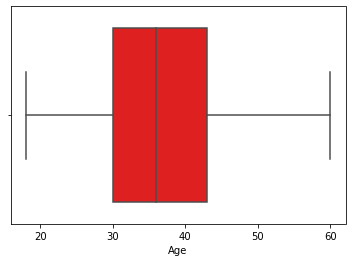

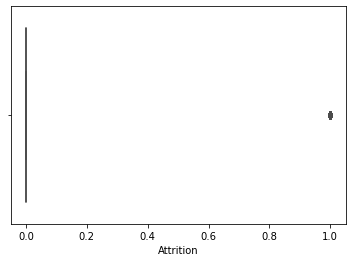

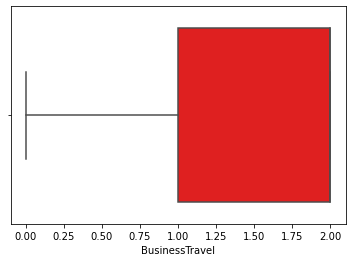

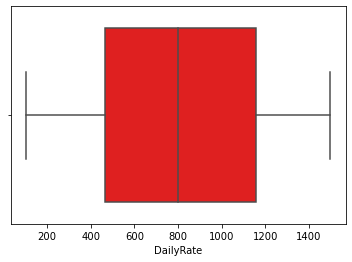

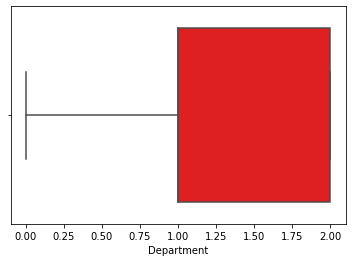

...

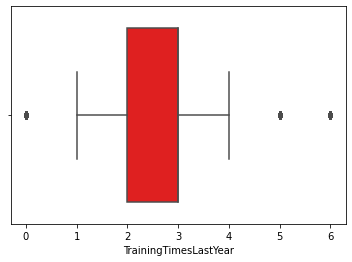

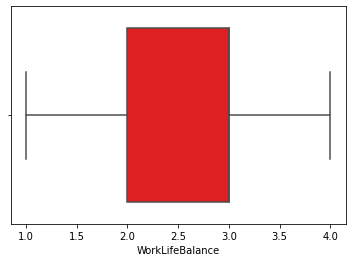

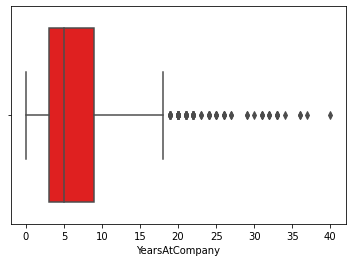

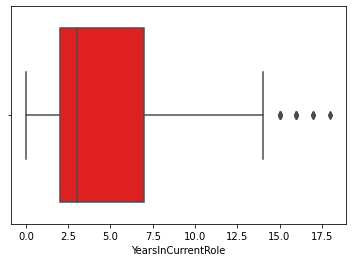

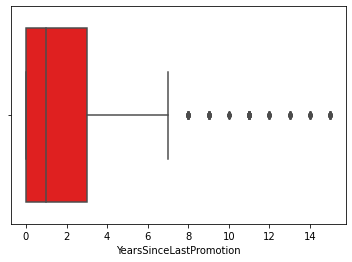

In [119]:
def bxplt(a):
    plt.figure()
    sns.boxplot(df[columns[a]],data=df,color='red')
for i in range(0,31):
    bxplt(i)

In [121]:
sns.distplot(data[''],color='brown',bins=5)

<AxesSubplot:xlabel='BusinessTravel', ylabel='Density'>

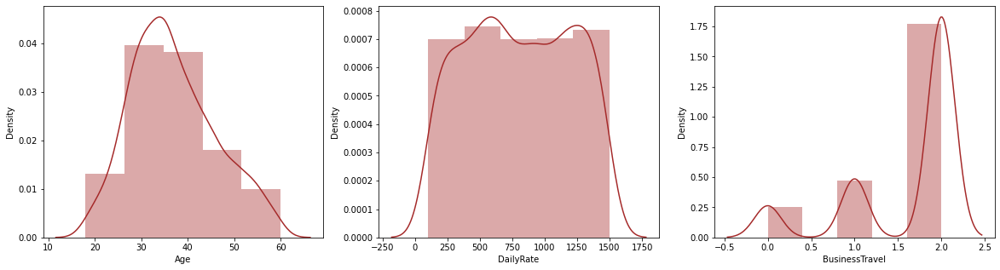

In [138]:
plt.figure(figsize=(20,5))
plt.subplot(1,3,1)
sns.distplot(df['Age'],color='brown',bins=5)
plt.subplot(1,3,2)
sns.distplot(df['DailyRate'],color='brown',bins=5)
plt.subplot(1,3,3)
sns.distplot(df['BusinessTravel'],color='brown',bins=5)


<AxesSubplot:xlabel='Education', ylabel='Density'>

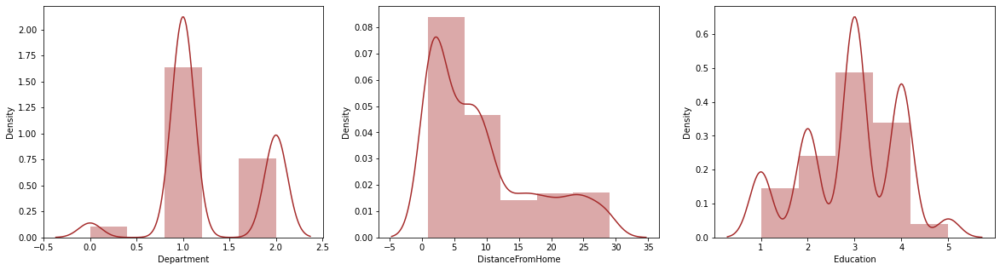

In [139]:
plt.figure(figsize=(20,5))
plt.subplot(1,3,1)
sns.distplot(df['Department'],color='brown',bins=5)
plt.subplot(1,3,2)
sns.distplot(df['DistanceFromHome'],color='brown',bins=5)
plt.subplot(1,3,3)
sns.distplot(df['Education'],color='brown',bins=5)


<AxesSubplot:xlabel='EnvironmentSatisfaction', ylabel='Density'>

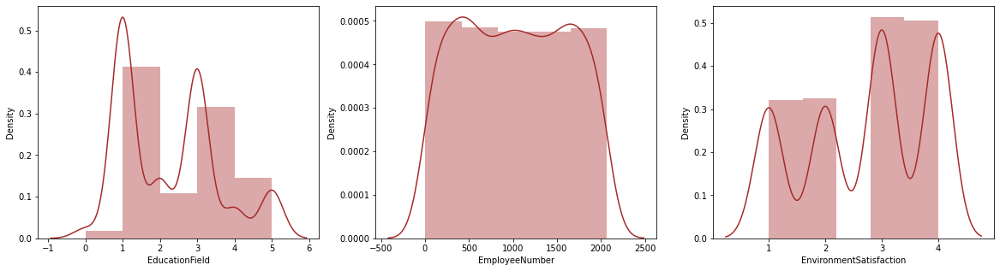

In [140]:
plt.figure(figsize=(20,5))
plt.subplot(1,3,1)
sns.distplot(df['EducationField'],color='brown',bins=5)
plt.subplot(1,3,2)
sns.distplot(df['EmployeeNumber'],color='brown',bins=5)
plt.subplot(1,3,3)
sns.distplot(df['EnvironmentSatisfaction'],color='brown',bins=5)


<AxesSubplot:xlabel='JobInvolvement', ylabel='Density'>

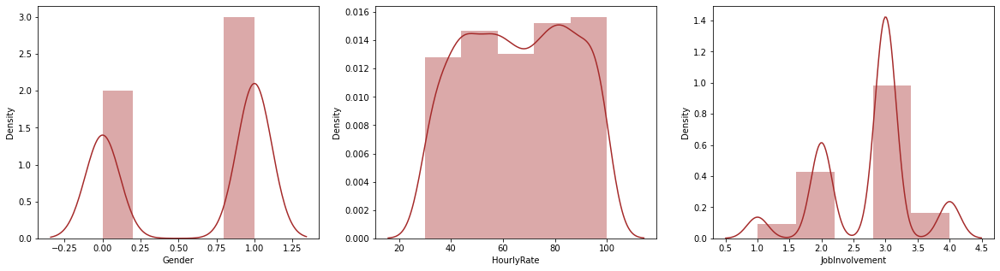

In [141]:
plt.figure(figsize=(20,5))
plt.subplot(1,3,1)
sns.distplot(df['Gender'],color='brown',bins=5)
plt.subplot(1,3,2)
sns.distplot(df['HourlyRate'],color='brown',bins=5)
plt.subplot(1,3,3)
sns.distplot(df['JobInvolvement'],color='brown',bins=5)


<AxesSubplot:xlabel='JobSatisfaction', ylabel='Density'>

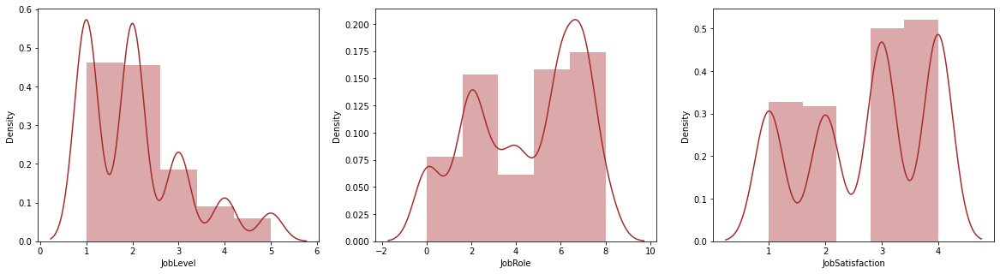

In [142]:
plt.figure(figsize=(20,5))
plt.subplot(1,3,1)
sns.distplot(df['JobLevel'],color='brown',bins=5)
plt.subplot(1,3,2)
sns.distplot(df['JobRole'],color='brown',bins=5)
plt.subplot(1,3,3)
sns.distplot(df['JobSatisfaction'],color='brown',bins=5)


<AxesSubplot:xlabel='MonthlyRate', ylabel='Density'>

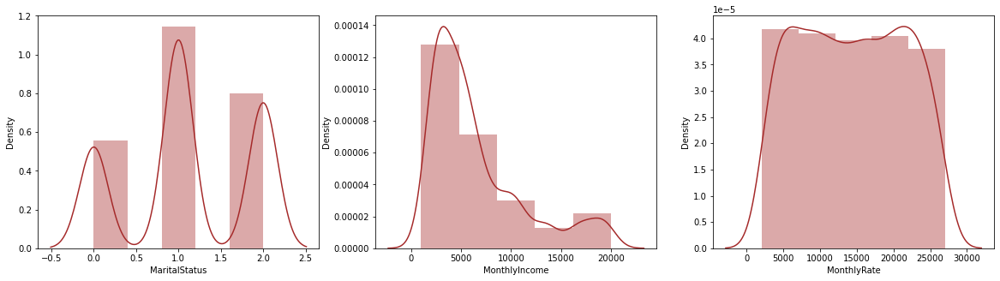

In [144]:
plt.figure(figsize=(20,5))
plt.subplot(1,3,1)
sns.distplot(df['MaritalStatus'],color='brown',bins=5)
plt.subplot(1,3,2)
sns.distplot(df['MonthlyIncome'],color='brown',bins=5)
plt.subplot(1,3,3)
sns.distplot(df['MonthlyRate'],color='brown',bins=5)


<AxesSubplot:xlabel='PercentSalaryHike', ylabel='Density'>

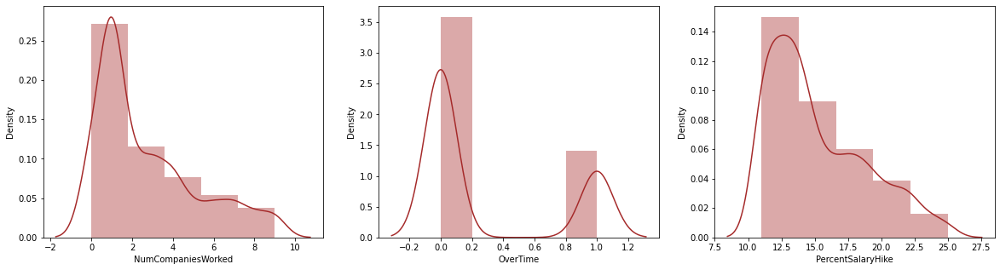

In [145]:
plt.figure(figsize=(20,5))
plt.subplot(1,3,1)
sns.distplot(df['NumCompaniesWorked'],color='brown',bins=5)
plt.subplot(1,3,2)
sns.distplot(df['OverTime'],color='brown',bins=5)
plt.subplot(1,3,3)
sns.distplot(df['PercentSalaryHike'],color='brown',bins=5)

<AxesSubplot:xlabel='StockOptionLevel', ylabel='Density'>

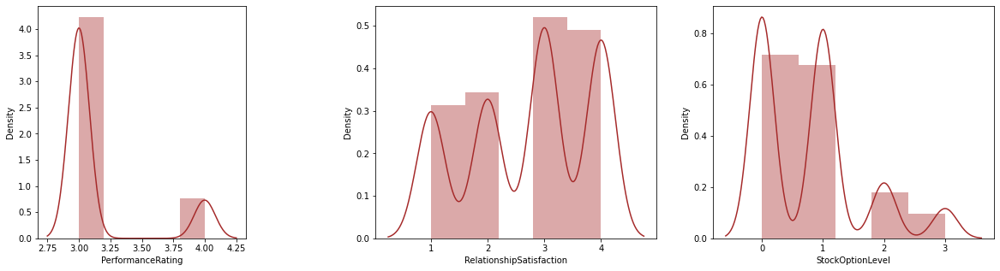

In [136]:
plt.figure(figsize=(20,5))
plt.subplot(1,3,1)
sns.distplot(df['PerformanceRating'],color='brown',bins=5)
plt.subplot(1,3,2)
sns.distplot(df['RelationshipSatisfaction'],color='brown',bins=5)
plt.subplot(1,3,3)
sns.distplot(df['StockOptionLevel'],color='brown',bins=5)

<AxesSubplot:xlabel='WorkLifeBalance', ylabel='Density'>

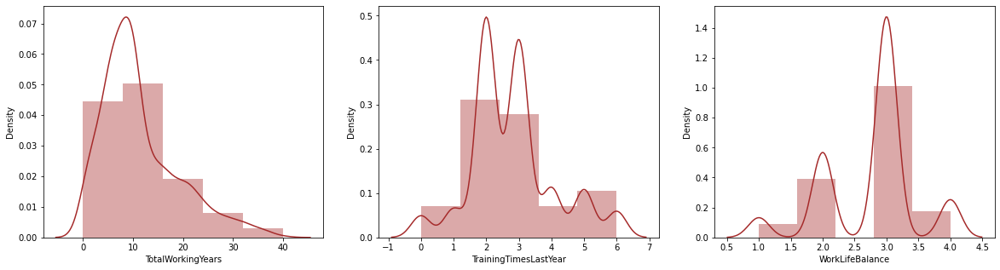

In [146]:
plt.figure(figsize=(20,5))
plt.subplot(1,3,1)
sns.distplot(df['TotalWorkingYears'],color='brown',bins=5)
plt.subplot(1,3,2)
sns.distplot(df['TrainingTimesLastYear'],color='brown',bins=5)
plt.subplot(1,3,3)
sns.distplot(df['WorkLifeBalance'],color='brown',bins=5)

<AxesSubplot:xlabel='YearsInCurrentRole', ylabel='Density'>

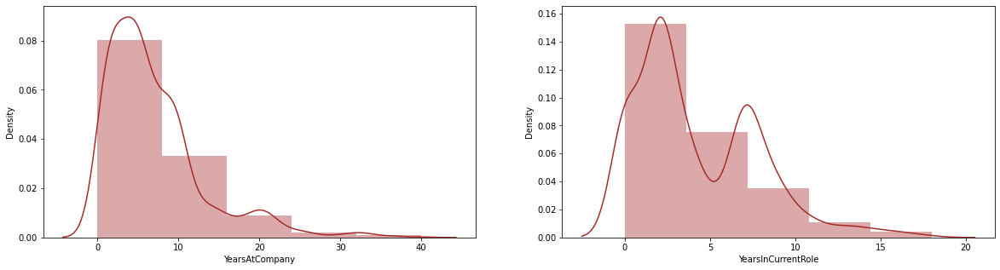

In [148]:
plt.figure(figsize=(20,5))
plt.subplot(1,2,1)
sns.distplot(df['YearsAtCompany'],color='brown',bins=5)
plt.subplot(1,2,2)
sns.distplot(df['YearsInCurrentRole'],color='brown',bins=5)


<AxesSubplot:xlabel='YearsWithCurrManager', ylabel='Density'>

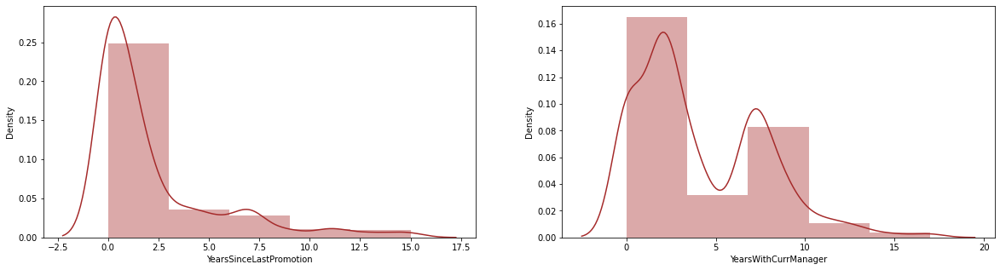

In [149]:
plt.figure(figsize=(20,5))
plt.subplot(1,2,1)
sns.distplot(df['YearsSinceLastPromotion'],color='brown',bins=5)
plt.subplot(1,2,2)
sns.distplot(df['YearsWithCurrManager'],color='brown',bins=5)

# Oversampling with SMOTE

# Removing outliers

In [19]:
#zscore
z=np.abs(zscore(df))
z

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeNumber,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyIncome,MonthlyRate,NumCompaniesWorked,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,0.446350,2.280906,0.590048,0.742527,1.401512,1.010909,0.891688,0.937414,1.701283,0.660531,1.224745,1.383138,0.379672,0.057788,1.032716,1.153254,1.236820,0.108350,0.726020,2.125136,1.591746,1.150554,0.426230,1.584178,0.932014,0.421642,2.171982,2.493820,0.164613,0.063296,0.679146,0.245834
1,1.322365,0.438422,0.913194,1.297775,0.493817,0.147150,1.868426,0.937414,1.699621,0.254625,0.816497,0.240677,1.026167,0.057788,0.626374,0.660853,0.133282,0.291719,1.488876,0.678049,0.628241,2.129306,2.346151,1.191438,0.241988,0.164511,0.155707,0.338096,0.488508,0.764998,0.368715,0.806541
2,0.008343,2.280906,0.590048,1.414363,0.493817,0.887515,0.891688,1.316673,1.696298,1.169781,0.816497,1.284725,1.026167,0.961486,0.998992,0.246200,1.236820,0.937654,1.674841,1.324226,1.591746,0.057267,0.426230,0.658973,0.932014,0.550208,0.155707,0.338096,1.144294,1.167687,0.679146,1.155935
3,0.429664,0.438422,0.913194,1.461466,0.493817,0.764121,1.061787,0.937414,1.694636,1.169781,1.224745,0.486709,0.379672,0.961486,0.626374,0.246200,0.133282,0.763634,1.243211,0.678049,1.591746,1.150554,0.426230,0.266233,0.932014,0.421642,0.155707,0.338096,0.161947,0.764998,0.252146,1.155935
4,1.086676,0.438422,0.590048,0.524295,0.493817,0.887515,1.868426,0.565311,1.691313,1.575686,0.816497,1.274014,0.379672,0.961486,0.998992,0.660853,0.133282,0.644858,0.325900,2.525591,0.628241,0.877232,0.426230,1.191438,0.241988,0.678774,0.155707,0.338096,0.817734,0.615492,0.058285,0.595227
5,0.539166,0.438422,0.913194,0.502054,0.493817,0.887515,0.891688,0.937414,1.689652,1.169781,0.816497,0.645041,0.379672,0.961486,0.998992,1.153254,1.236820,0.729850,0.344199,1.078504,0.628241,0.603911,0.426230,0.266233,0.932014,0.421642,0.620189,1.077862,0.001333,0.764998,0.252146,0.526188
6,2.417384,0.438422,0.590048,1.292887,0.493817,0.764121,0.085049,0.565311,1.686328,0.254625,1.224745,0.743454,1.785511,0.961486,0.998992,1.567907,0.133282,0.814416,0.611227,0.523316,1.591746,1.309341,2.346151,1.584178,2.589994,0.092620,0.155707,1.077862,0.981014,1.167687,0.679146,1.155935
7,0.758170,0.438422,0.590048,1.377177,0.493817,1.827158,1.868426,0.937414,1.684667,1.169781,0.816497,0.054562,0.379672,0.961486,0.998992,0.246200,1.503385,0.809529,0.137464,0.678049,0.628241,1.855984,2.346151,0.658973,0.241988,1.321601,0.620189,0.338096,0.981014,1.167687,0.679146,1.155935
8,0.117845,0.438422,0.913194,1.453958,0.493817,1.703764,0.085049,0.937414,1.683005,1.169781,0.816497,1.077188,1.026167,0.845911,0.186309,0.246200,1.236820,0.642338,0.776644,1.078504,0.628241,1.582663,2.346151,0.658973,0.932014,0.164511,0.620189,0.338096,0.325228,0.764998,0.368715,1.086895
9,0.101159,0.438422,0.590048,1.230910,0.493817,2.197341,0.085049,0.565311,1.681343,0.254625,0.816497,1.383138,0.379672,0.057788,1.811675,0.246200,0.133282,0.268983,0.318170,1.324226,0.628241,0.603911,0.426230,0.658973,1.415991,0.735447,0.155707,1.077862,0.001333,0.764998,1.493867,0.806541


In [237]:
threshold=3
print(np.where(z>3))

(array([  28,   45,   62,   62,   63,   64,   85,   98,   98,  110,  123,
        123,  123,  126,  126,  126,  153,  178,  187,  187,  190,  190,
        218,  231,  231,  237,  237,  270,  270,  281,  326,  386,  386,
        401,  411,  425,  425,  427,  445,  466,  473,  477,  535,  561,
        561,  584,  592,  595,  595,  595,  616,  624,  635,  653,  653,
        677,  686,  701,  716,  746,  749,  752,  799,  838,  861,  861,
        875,  875,  894,  914,  914,  918,  922,  926,  926,  937,  956,
        962,  976,  976, 1008, 1024, 1043, 1078, 1078, 1086, 1086, 1093,
       1111, 1116, 1116, 1135, 1138, 1138, 1156, 1184, 1221, 1223, 1242,
       1295, 1301, 1301, 1303, 1327, 1331, 1348, 1351, 1401, 1414, 1430],
      dtype=int64), array([31, 30, 28, 30, 29, 30, 25, 25, 28, 30, 29, 30, 31, 25, 28, 30, 31,
       30, 25, 31, 28, 29, 30, 29, 31, 28, 30, 25, 28, 29, 30, 30, 31, 25,
       28, 28, 30, 30, 25, 29, 28, 28, 30, 28, 31, 30, 28, 25, 28, 30, 31,
       25, 31, 28, 30, 

In [20]:
df_new1=df[(z<3).all(axis=1)]

In [21]:
df_new1.shape[0]

1387

In [22]:
#chcking data loss
data_loss=((df.shape[0]-df_new1.shape[0])/df.shape[0])*100
print(data_loss)

5.646258503401361


since the data loss is less.The data loss is acceptable we can go ahead with the data

In [23]:
#saving the upadated dataset 
df=df_new1

# Skewness Removal

In [24]:
#initialising X and y
X=df.drop(['Attrition'],axis=1)
y=df.Attrition

In [25]:
df.shape

(1387, 32)

In [244]:
X.skew().sort_values(ascending=False)

PerformanceRating           1.931566
YearsSinceLastPromotion     1.756335
MonthlyIncome               1.544770
YearsAtCompany              1.248623
JobLevel                    1.126075
NumCompaniesWorked          1.037715
TotalWorkingYears           1.034487
StockOptionLevel            0.962332
DistanceFromHome            0.954752
OverTime                    0.954751
PercentSalaryHike           0.800592
YearsInCurrentRole          0.726675
YearsWithCurrManager        0.694506
TrainingTimesLastYear       0.577614
EducationField              0.544868
Age                         0.472280
Department                  0.183919
MonthlyRate                 0.030596
EmployeeNumber              0.018931
DailyRate                  -0.017078
HourlyRate                 -0.030481
MaritalStatus              -0.160952
Education                  -0.289024
RelationshipSatisfaction   -0.295686
EnvironmentSatisfaction    -0.325285
JobSatisfaction            -0.345612
JobRole                    -0.386843
G

In [27]:
feat=['PerformanceRating','YearsSinceLastPromotion','MonthlyIncome','YearsAtCompany','JobLevel','NumCompaniesWorked','JobLevel',
 'NumCompaniesWorked','TotalWorkingYears','StockOptionLevel','DistanceFromHome','PercentSalaryHike','YearsInCurrentRole',
 'YearsWithCurrManager','TrainingTimesLastYear','JobInvolvement','WorkLifeBalance']

BusinessTravel,OverTime,EducationField are categorical columns so we can ignore the skewness

In [28]:
from sklearn.preprocessing import PowerTransformer
X[feat]=PowerTransformer().fit_transform(X[feat])

In [247]:
X.skew().sort_values(ascending=False)

OverTime                    0.954751
EducationField              0.544868
Age                         0.472280
YearsSinceLastPromotion     0.212301
Department                  0.183919
PercentSalaryHike           0.112128
JobLevel                    0.110769
StockOptionLevel            0.089929
TrainingTimesLastYear       0.057949
MonthlyRate                 0.030596
MonthlyIncome               0.027700
EmployeeNumber              0.018931
NumCompaniesWorked          0.016175
PerformanceRating           0.000000
DistanceFromHome           -0.008149
TotalWorkingYears          -0.009666
WorkLifeBalance            -0.011133
DailyRate                  -0.017078
JobInvolvement             -0.018801
YearsAtCompany             -0.025230
HourlyRate                 -0.030481
YearsInCurrentRole         -0.069631
YearsWithCurrManager       -0.070570
MaritalStatus              -0.160952
Education                  -0.289024
RelationshipSatisfaction   -0.295686
EnvironmentSatisfaction    -0.325285
J

BusinessTravel,EducationField,OverTime are categorical columns so wedont need to reduce the skewness in these columns

skewness in the dataset has been completely removed

# Oversampling with SMOTE

In [29]:
from imblearn.over_sampling import SMOTE
SM = SMOTE()
X,y = SM.fit_resample(X,y)

In [30]:
# Checking the updated value counts 
y.value_counts()

1    1158
0    1158
Name: Attrition, dtype: int64

In [250]:
y.shape

(2316,)

In [251]:
X.shape

(2316, 31)

the dataset is balanced ,lets do the pca now

# Scaling the data

In [31]:
scaler=StandardScaler()
X_scaled=scaler.fit_transform(X)
X=pd.DataFrame(X_scaled,columns=X.columns)

we can do the PCA here

In [32]:
from sklearn.decomposition import PCA
pca=PCA()
pca.fit_transform(X_scaled)

array([[ 1.02783216, -0.02764695, -2.43637879, ..., -0.87050225,
         0.24214985,  0.00927589],
       [ 1.88449961, -0.66019271,  2.13121763, ..., -0.67020819,
         0.16947088,  0.12455913],
       [-2.95787716,  1.13263575, -0.95979476, ...,  0.24882409,
        -0.18391653,  0.48475512],
       ...,
       [-3.41568634, -1.72719222,  1.57723862, ..., -0.03107283,
        -0.27356234,  0.1883147 ],
       [-1.09724541, -0.29845724,  0.79665712, ..., -0.02142529,
         0.20096801,  0.10954988],
       [-3.42740579, -0.95841156,  0.03665575, ...,  0.12933706,
        -0.03903094, -0.38757093]])

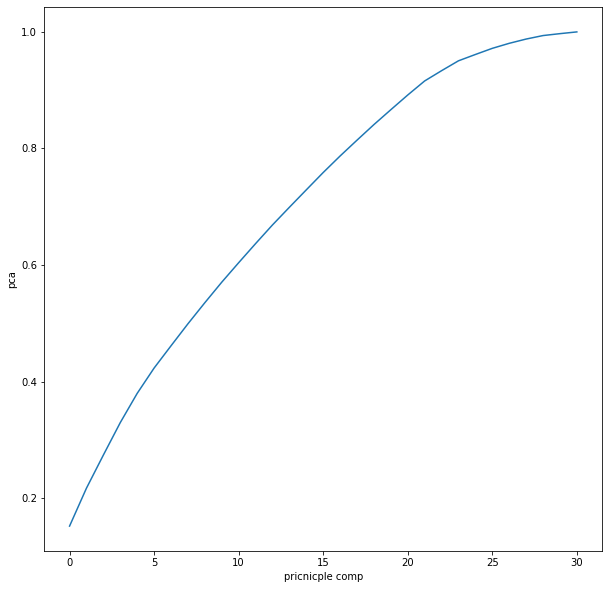

In [33]:
plt.figure(figsize=(10,10))
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel("pricnicple comp")
plt.ylabel("pca")
plt.show()

based on the plot 27 features are explaining the data set. So we can go with no. 27 as no of components

In [34]:
pca=PCA(n_components=27)

In [35]:
new_pcomp=pca.fit_transform(X_scaled)
princi_comp=pd.DataFrame(new_pcomp,columns=['PC1','PC2','PC3','PC4','PC5','PC6','PC7','PC8','PC9','PC10','PC11',
                                            'PC12','PC13','PC14','PC15','PC16','PC17','PC18','PC19','PC20','PC21',
                                            'P22','PC23','PC24','PC25','PC26','PC27'])
princi_comp.shape

(2316, 27)

In [36]:

#initialising x  with updated data
X=princi_comp


# checking multicollinearity

In [37]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

vif=pd.DataFrame()
vif['vif']=[variance_inflation_factor(X_scaled,i) for i in range(X.shape[1])]
vif['features']=X.columns

In [259]:
X

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14,PC15,PC16,PC17,PC18,PC19,PC20,PC21,P22,PC23,PC24,PC25,PC26,PC27
0,1.112229,0.008026,-2.939375,-0.280536,-1.186562,0.151036,3.004357,-0.924070,2.578909,1.338053,-1.570711,-1.782888,1.674773,0.874037,-1.330398,1.136375,0.309197,-0.267109,0.192785,-0.062553,0.883468,-0.556475,1.277093,-0.806253,-0.453614,-0.571348,-0.337503
1,1.954141,-0.604563,0.940873,2.818069,0.788000,-0.057577,0.164064,-1.353388,-2.225458,0.446453,1.154847,0.070068,-0.979487,1.646194,-1.563772,-0.397616,-0.949122,-0.789981,-1.197099,0.372910,0.062785,-0.674658,1.176549,1.232307,-0.121081,0.363409,-0.906707
2,-2.858694,1.245018,-1.262808,-0.018735,-0.706106,3.215378,-1.104977,-0.843831,2.479994,-0.676212,-0.569156,1.051927,0.631790,0.879417,-1.041395,-0.058221,-0.351278,1.106985,0.460237,1.119398,0.388733,-1.446743,0.088227,-0.094951,0.376281,-0.713262,0.243339
3,0.110301,-1.005749,-0.512060,-1.025977,-0.134315,1.097737,2.143901,-0.538852,0.710887,-0.108327,1.445285,0.116329,1.487272,0.516723,1.008296,-1.365133,1.659810,0.132135,-0.842316,0.291279,-1.387001,-1.305907,-0.237893,0.601251,-0.930714,0.653230,0.381969
4,-0.926860,0.715545,0.316236,-1.566027,-0.560499,1.027848,-1.095330,-2.295514,-0.662288,0.710498,0.602974,-0.200580,0.010143,-0.532166,-1.653848,-0.488713,-0.902241,-2.200887,-0.053358,-1.118354,-0.573588,-0.694795,-0.889021,-0.677405,-0.256580,-0.906754,-0.572995
5,0.605604,-2.385055,1.128170,-0.949447,-1.037514,2.667043,1.406391,-0.447516,-0.130846,1.389057,-0.245894,-0.080263,0.217235,1.504134,0.292579,0.737212,0.147741,-0.272423,-1.116542,1.032645,0.584776,-0.870363,0.031106,0.652823,0.024197,-0.530803,0.160418
6,-1.218086,3.487653,0.667111,2.609604,1.057456,1.354320,-0.245036,0.728947,2.752899,-0.833507,-0.497779,-1.574126,1.815425,0.392591,-0.216600,-1.578283,-0.213988,-1.358357,0.551139,1.242534,0.631679,-0.587836,0.259260,1.856777,-0.808879,-1.427429,-1.176179
7,-3.315959,1.353698,1.901135,1.972712,2.028369,1.362067,0.566813,-0.955404,0.429006,-0.694276,-0.046677,-1.323656,-1.542131,0.546769,0.327547,1.164247,-1.408880,0.074371,-1.382137,0.570756,0.000862,-1.541503,-0.233252,0.346902,-0.802331,-0.227000,0.403871
8,2.159920,-2.097753,0.888465,3.432920,-0.649937,0.366020,0.565259,-1.341041,-1.603993,-0.214627,-0.000929,0.576032,-1.068215,-0.377321,1.022205,0.538588,-0.925556,0.765418,-1.047464,2.300404,0.901894,-0.366879,0.403234,0.130574,-0.445279,0.263243,-0.310989
9,2.898656,1.042832,1.567311,-0.853739,-0.352753,1.385712,0.189083,0.016724,0.784864,0.007141,-0.550289,-1.195959,-1.815940,-0.039128,-0.770429,-0.325959,1.106196,0.185252,0.129709,0.256642,0.530803,-2.290198,-0.922609,-0.627995,-0.110938,-1.354167,-0.649104


In [38]:
vif

,vif,features
0,1.944436,PC1
1,1.031888,PC2
2,1.041069,PC3
3,1.912398,PC4
4,1.045017,PC5
5,1.077372,PC6
6,1.038711,PC7
7,1.047324,PC8
8,1.076874,PC9
9,1.064262,PC10


vif score is less than 10% so we can ignore the multicloolinearity in the dataset

<AxesSubplot:>

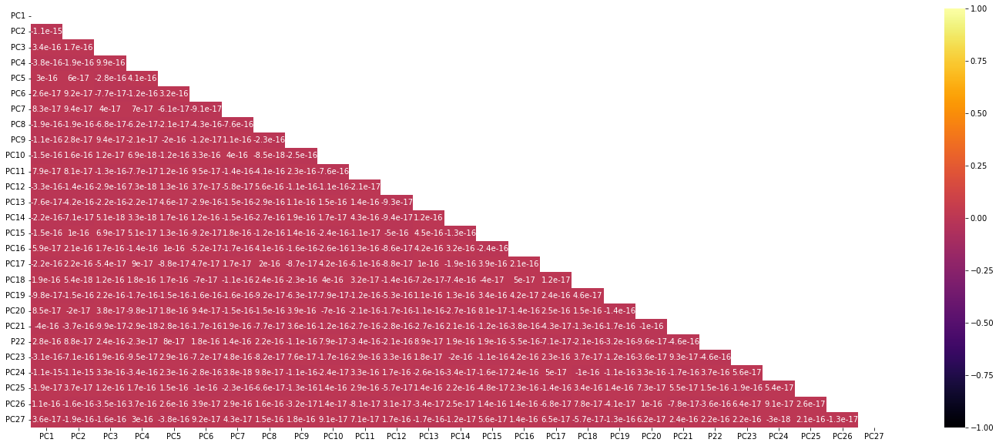

In [264]:
 
upper_triangle = np.triu(X.corr())
plt.figure(figsize=(25,10))
sns.heatmap(X.corr() , vmin=-1, vmax=1, annot=True,cmap="inferno", mask=upper_triangle)

the data looks good

# Model Building

In [39]:
#X,y already initialized
X.shape

(2316, 27)

In [40]:
y.shape

(2316,)

In [267]:
#finding best random_state

maxAccu=0
maxRS=0
for i in range(1,100):
    x_train,x_test,y_train,y_test=train_test_split(X,y,test_size=.25,random_state=i)
    rf=RandomForestClassifier(n_estimators=100)
    rf.fit(x_train,y_train)
    
    predrf=rf.predict(x_test)
    acc=accuracy_score(y_test,predrf)
    if acc>maxAccu:
        maxAccu=acc
        maxRS=i
print("Best accuracy is ",maxAccu," on random_state ",maxRS)

Best accuracy is  0.9101899827288429  on random_state  30


In [41]:
x_train,x_test,y_train,y_test=train_test_split(X,y,test_size=.25,random_state=30)

In [42]:
# different algorithm going to use

lg=LogisticRegression()
knn=KNeighborsClassifier()
sv=SVC()
dtc=DecisionTreeClassifier()
rf=RandomForestClassifier(n_estimators=100)
ada=AdaBoostClassifier(n_estimators=100)
gd=GradientBoostingClassifier()
xgb=XGBClassifier()

In [43]:
#code for Training and Prediction 

def evaluate(x):
    model=x
    print(model)
    #training the model
    model.fit(x_train,y_train)
    pred_train=model.predict(x_train)
    #model prediction
    pred=model.predict(x_test)
    
    print("train accuracy score is {:.2f}%".format(accuracy_score(y_train,pred_train)*100))
    print("test accuracy score is {:.2f}%".format(accuracy_score(y_test,pred)*100))
    
    print("\n")
    print("Confusion Matrix : \n",confusion_matrix(y_test,pred))
    print("\n")
    print("Classification Report  : \n",classification_report(y_test,pred))

In [282]:
#calling LogisticRegressionClassifier
evaluate(lg)

LogisticRegression()
train accuracy score is 79.68%
test accuracy score is 82.56%


Confusion Matrix : 
 [[243  48]
 [ 53 235]]


Classification Report  : 
               precision    recall  f1-score   support

           0       0.82      0.84      0.83       291
           1       0.83      0.82      0.82       288

    accuracy                           0.83       579
   macro avg       0.83      0.83      0.83       579
weighted avg       0.83      0.83      0.83       579



In [283]:
#calling KNeighborsClassifier
evaluate(knn)

KNeighborsClassifier()
train accuracy score is 84.51%
test accuracy score is 79.27%


Confusion Matrix : 
 [[173 118]
 [  2 286]]


Classification Report  : 
               precision    recall  f1-score   support

           0       0.99      0.59      0.74       291
           1       0.71      0.99      0.83       288

    accuracy                           0.79       579
   macro avg       0.85      0.79      0.78       579
weighted avg       0.85      0.79      0.78       579



In [284]:
#calling SVC Classifier
evaluate(sv)

SVC()
train accuracy score is 95.62%
test accuracy score is 91.02%


Confusion Matrix : 
 [[263  28]
 [ 24 264]]


Classification Report  : 
               precision    recall  f1-score   support

           0       0.92      0.90      0.91       291
           1       0.90      0.92      0.91       288

    accuracy                           0.91       579
   macro avg       0.91      0.91      0.91       579
weighted avg       0.91      0.91      0.91       579



In [285]:
#calling DecisionTreeClassifier
evaluate(dtc)

DecisionTreeClassifier()
train accuracy score is 100.00%
test accuracy score is 80.83%


Confusion Matrix : 
 [[225  66]
 [ 45 243]]


Classification Report  : 
               precision    recall  f1-score   support

           0       0.83      0.77      0.80       291
           1       0.79      0.84      0.81       288

    accuracy                           0.81       579
   macro avg       0.81      0.81      0.81       579
weighted avg       0.81      0.81      0.81       579



In [286]:
#calling RandomForestClassifier
evaluate(rf)

RandomForestClassifier()
train accuracy score is 100.00%
test accuracy score is 90.33%


Confusion Matrix : 
 [[263  28]
 [ 28 260]]


Classification Report  : 
               precision    recall  f1-score   support

           0       0.90      0.90      0.90       291
           1       0.90      0.90      0.90       288

    accuracy                           0.90       579
   macro avg       0.90      0.90      0.90       579
weighted avg       0.90      0.90      0.90       579



In [287]:
#calling AdaBoostClassifier
evaluate(ada)

AdaBoostClassifier(n_estimators=100)
train accuracy score is 90.33%
test accuracy score is 82.73%


Confusion Matrix : 
 [[242  49]
 [ 51 237]]


Classification Report  : 
               precision    recall  f1-score   support

           0       0.83      0.83      0.83       291
           1       0.83      0.82      0.83       288

    accuracy                           0.83       579
   macro avg       0.83      0.83      0.83       579
weighted avg       0.83      0.83      0.83       579



In [288]:
#calling GradientBoostingClassifier
evaluate(gd)

GradientBoostingClassifier()
train accuracy score is 94.99%
test accuracy score is 86.01%


Confusion Matrix : 
 [[246  45]
 [ 36 252]]


Classification Report  : 
               precision    recall  f1-score   support

           0       0.87      0.85      0.86       291
           1       0.85      0.88      0.86       288

    accuracy                           0.86       579
   macro avg       0.86      0.86      0.86       579
weighted avg       0.86      0.86      0.86       579



In [290]:
#calling XGBClassifier
evaluate(xgb)

XGBClassifier(base_score=0.5, booster='gbtree', callbacks=None,
              colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
              early_stopping_rounds=None, enable_categorical=False,
              eval_metric=None, gamma=0, gpu_id=-1, grow_policy='depthwise',
              importance_type=None, interaction_constraints='',
              learning_rate=0.300000012, max_bin=256, max_cat_to_onehot=4,
              max_delta_step=0, max_depth=6, max_leaves=0, min_child_weight=1,
              missing=nan, monotone_constraints='()', n_estimators=100,
              n_jobs=0, num_parallel_tree=1, predictor='auto', random_state=0,
              reg_alpha=0, reg_lambda=1, ...)
train accuracy score is 100.00%
test accuracy score is 90.33%


Confusion Matrix : 
 [[256  35]
 [ 21 267]]


Classification Report  : 
               precision    recall  f1-score   support

           0       0.92      0.88      0.90       291
           1       0.88      0.93      0.91       288



In [292]:
model=[lg,knn,sv,dtc,rf,ada,gd,xgb]

for m in model:
    score=cross_val_score(m,X,y,cv=5)
    print(m,"Cross val score is ",score*100,"   ")
    print("mean is ",score.mean()*100,"\n\n")



LogisticRegression() Cross val score is  [60.56034483 81.64146868 80.7775378  80.12958963 73.00215983]    
mean is  75.22222015342221 


KNeighborsClassifier() Cross val score is  [72.62931034 79.91360691 75.80993521 76.88984881 75.16198704]    
mean is  76.080937662918 


SVC() Cross val score is  [69.18103448 92.22462203 90.71274298 92.22462203 88.12095032]    
mean is  86.49279436955389 


DecisionTreeClassifier() Cross val score is  [65.30172414 74.29805616 80.12958963 78.61771058 75.37796976]    
mean is  74.74501005436807 


RandomForestClassifier() Cross val score is  [72.4137931  91.36069114 92.65658747 89.8488121  84.44924406]    
mean is  86.14582557533328 


AdaBoostClassifier(n_estimators=100) Cross val score is  [57.32758621 84.8812095  82.72138229 82.72138229 77.96976242]    
mean is  77.1242645415953 


GradientBoostingClassifier() Cross val score is  [68.96551724 88.33693305 86.825054   85.74514039 81.64146868]    
mean is  82.30282267073805 


XGBClassifier(base_score=

By comparing both cross validation accuracy and actual accuracy. It is found that KNeighborsClassifier is the best model with a difference of 3.19%.

# Hyper Parameter Tuning - GridSearchCV

In [44]:
#checking the parameters for KNeighborsClassifier model
knn.get_params()

{'algorithm': 'auto',
 'leaf_size': 30,
 'metric': 'minkowski',
 'metric_params': None,
 'n_jobs': None,
 'n_neighbors': 5,
 'p': 2,
 'weights': 'uniform'}

In [58]:
grid_params = {'n_neighbors':range(1,10,1),     #parameters for KNN classifier
             'weights':['uniform','distance'],
             'leaf_size':range(5,100,5),
               'metric_params':['dict',None],
             'algorithm':['auto','ball_tree','kd_tree','brute'],
              'metric':['str','minkowski']}

In [59]:
from sklearn.model_selection import GridSearchCV

grid_search= GridSearchCV(estimator=knn,param_grid=grid_params,cv= 5,n_jobs=-1)

In [60]:
grid_search.fit(x_train, y_train)

GridSearchCV(cv=5, estimator=KNeighborsClassifier(), n_jobs=-1,
             param_grid={'algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute'],
                         'leaf_size': range(5, 100, 5),
                         'metric': ['str', 'minkowski'],
                         'metric_params': ['dict', None],
                         'n_neighbors': range(1, 10),
                         'weights': ['uniform', 'distance']})

In [61]:
grid_search.best_params_

{'algorithm': 'auto',
 'leaf_size': 5,
 'metric': 'minkowski',
 'metric_params': None,
 'n_neighbors': 2,
 'weights': 'uniform'}

In [62]:
hknn = KNeighborsClassifier(algorithm='auto',leaf_size=5,metric= 'minkowski',n_neighbors= 2,weights= 'uniform',
                            metric_params=None)

In [63]:
evaluate(hknn)

KNeighborsClassifier(leaf_size=5, n_neighbors=2)
train accuracy score is 99.48%
test accuracy score is 88.08%


Confusion Matrix : 
 [[234  57]
 [ 12 276]]


Classification Report  : 
               precision    recall  f1-score   support

           0       0.95      0.80      0.87       291
           1       0.83      0.96      0.89       288

    accuracy                           0.88       579
   macro avg       0.89      0.88      0.88       579
weighted avg       0.89      0.88      0.88       579



In [ ]:
with hypertuning the models accuracy is increased,so we will go with KNeighborsClassifier model with  hypertuning .the accuracy increased from
79.27 % to 88.08 %.

# AUC_ROC CURVE

In [65]:
from sklearn.metrics import roc_auc_score 
from sklearn.metrics import plot_roc_curve 

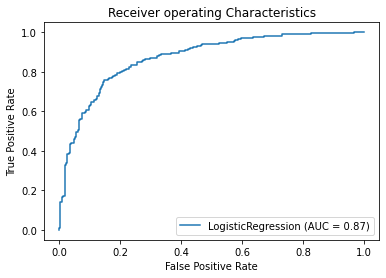

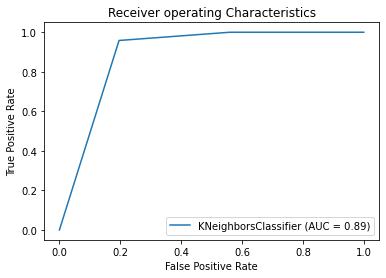

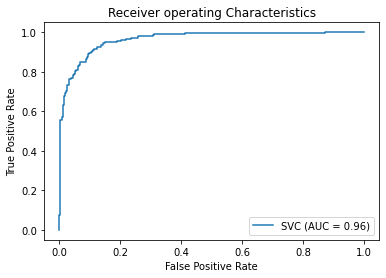

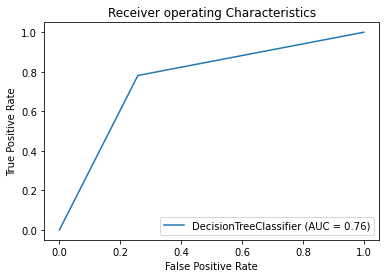

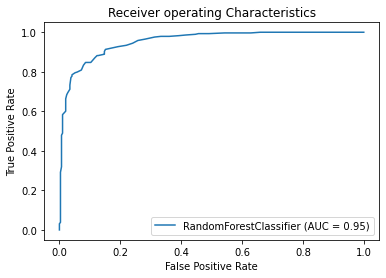

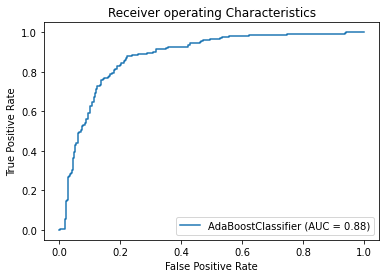

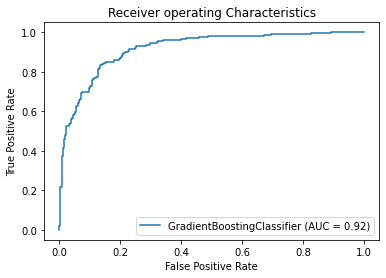

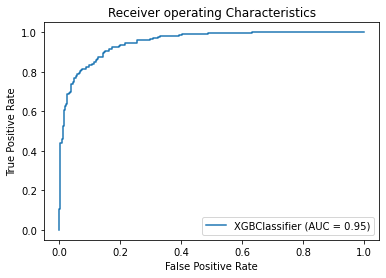

In [68]:
#lets see how well our model works on train data

model=[lg,hknn,sv,dtc,rf,ada,gd,xgb]
for m in model:
    ax=m.fit(x_train,y_train)
    plot_roc_curve(ax,x_test,y_test)
    plt.title('Receiver operating Characteristics')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
plt.show()

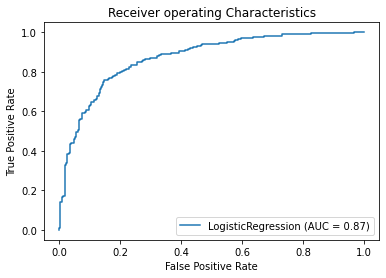

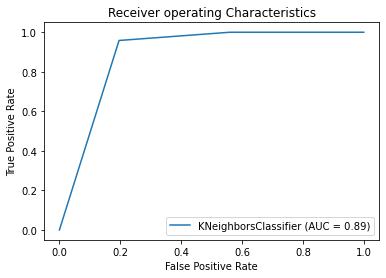

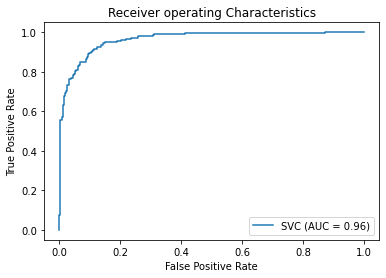

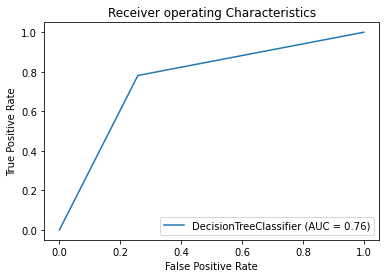

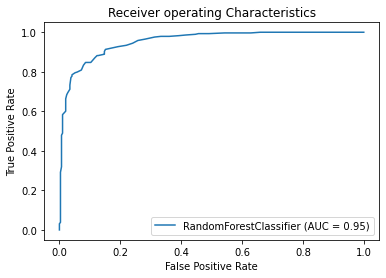

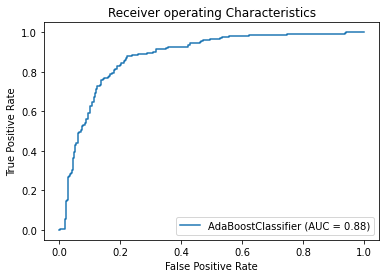

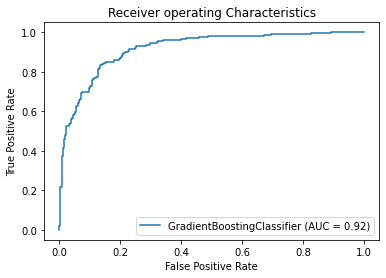

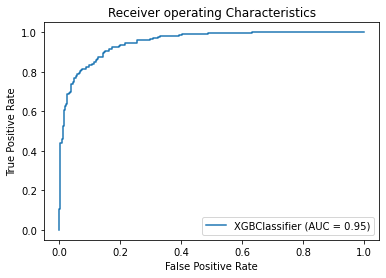

In [69]:
#lets see how well our model works on test data

model=[lg,hknn,sv,dtc,rf,ada,gd,xgb]
for m in model:
    plot_roc_curve(m,x_test,y_test)
    plt.title('Receiver operating Characteristics')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.show()

with knn we are getting the 89% in the Roc plot

# Conclusion

In [70]:
#saving the model
joblib.dump(hknn,"Attrition_in_HR.obj")

['Attrition_in_HR.obj']

In [71]:
#Lets Check loading the file 

Attrition_in_HR_prediction=joblib.load("Attrition_in_HR.obj")

In [73]:
pred=hknn.predict(x_test)
Conclusion=pd.DataFrame([Attrition_in_HR_prediction.predict(x_test)[:],pred[:]],index=["Predicted","Original"])
Conclusion

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578
Predicted,0,0,1,0,1,1,1,0,1,0,1,1,1,0,0,1,1,1,1,0,1,1,0,1,1,0,0,0,1,0,1,1,0,0,0,0,1,0,0,0,1,0,0,1,1,1,1,0,1,0,0,0,0,1,1,1,1,1,1,1,1,1,1,0,0,0,1,1,0,0,1,0,1,1,1,0,0,0,1,0,0,0,1,0,1,1,1,1,1,1,0,0,1,0,0,0,0,0,0,1,0,0,1,1,1,0,0,1,1,1,0,0,0,1,1,0,0,0,1,0,0,1,1,0,1,0,1,1,1,1,0,1,1,0,1,1,1,0,1,1,1,0,0,1,1,1,1,1,0,0,1,1,0,1,1,1,1,0,1,1,0,0,0,1,1,1,1,1,0,0,1,0,0,1,1,1,1,0,0,0,1,1,1,1,1,0,1,0,1,0,1,0,1,1,1,1,0,1,0,0,1,0,1,0,1,0,1,1,1,1,0,1,1,1,0,1,1,1,0,0,1,1,0,1,1,1,1,0,0,0,0,0,1,1,0,1,1,1,0,1,0,1,1,1,1,0,0,1,1,0,1,0,1,1,1,1,0,0,0,0,1,1,1,0,0,1,1,0,1,0,1,1,0,0,0,1,0,0,1,0,1,0,0,1,1,0,0,0,1,0,1,0,1,0,1,1,1,0,1,1,0,1,1,1,1,1,0,0,0,1,0,0,1,1,1,0,1,1,0,0,1,0,0,1,0,0,1,1,1,1,0,1,1,1,1,0,0,0,1,1,1,0,0,1,1,1,0,1,0,0,0,1,1,1,1,1,1,0,1,1,0,1,1,1,0,1,0,1,1,1,1,1,0,1,0,0,0,0,1,1,0,0,1,1,1,0,1,1,0,1,1,0,1,0,0,1,1,1,1,1,0,0,1,1,1,1,1,0,1,1,1,0,0,1,0,1,1,0,1,0,0,0,0,1,1,0,0,1,0,1,0,1,1,1,1,1,1,1,0,0,0,0,0,1,1,1,0,0,0,1,1,1,0,1,0,1,0,0,0,1,1,1,1,1,1,0,0,0,0,1,0,0,1,0,1,1,0,1,0,1,0,1,0,1,1,1,1,1,0,0,1,0,0,1,1,0,1,1,1,1,1,1,1,0,1,1,0,1,0,1,1,1,1,0,1,0,1,1,0,1,0,0,1,1,1,0,0,1,0,1,1,0,0,0,1,1,1,0,1,1,0,1,0,1,1,0,0,1,1,0,1,1,1,0,1,0,0,1,0,1,0,0,1,1,1,1,1,0,1,1,1,0,1,0,1,0,1,0,0
Original,0,0,1,0,1,1,1,0,1,0,1,1,1,0,0,1,1,1,1,0,1,1,0,1,1,0,0,0,1,0,1,1,0,0,0,0,1,0,0,0,1,0,0,1,1,1,1,0,1,0,0,0,0,1,1,1,1,1,1,1,1,1,1,0,0,0,1,1,0,0,1,0,1,1,1,0,0,0,1,0,0,0,1,0,1,1,1,1,1,1,0,0,1,0,0,0,0,0,0,1,0,0,1,1,1,0,0,1,1,1,0,0,0,1,1,0,0,0,1,0,0,1,1,0,1,0,1,1,1,1,0,1,1,0,1,1,1,0,1,1,1,0,0,1,1,1,1,1,0,0,1,1,0,1,1,1,1,0,1,1,0,0,0,1,1,1,1,1,0,0,1,0,0,1,1,1,1,0,0,0,1,1,1,1,1,0,1,0,1,0,1,0,1,1,1,1,0,1,0,0,1,0,1,0,1,0,1,1,1,1,0,1,1,1,0,1,1,1,0,0,1,1,0,1,1,1,1,0,0,0,0,0,1,1,0,1,1,1,0,1,0,1,1,1,1,0,0,1,1,0,1,0,1,1,1,1,0,0,0,0,1,1,1,0,0,1,1,0,1,0,1,1,0,0,0,1,0,0,1,0,1,0,0,1,1,0,0,0,1,0,1,0,1,0,1,1,1,0,1,1,0,1,1,1,1,1,0,0,

we can see it is giving exact data as result. The model is working well.The datas predicted are perfectly matching. The jobfile created is working well almost giving good accuracy.

After Training and Testing Eight algorithm model. The best accuracy model was determined as KNeighborsClassifier (hypertuned model) with 88.08% true accuracy after all the data cleaning, pre-processing, training and prediction as well .